# Time-Series Forecasting of Carbon Monoxide and Nitrogen Dioxide Levels

Build predictive models to forecast daily or hourly concentrations of **CO(GT)** and **NO₂(GT)** based on historical data.


In [5]:
!pip install statsmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 84.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 13.5 MB/s eta 0:00:00


In [7]:
!pip install --upgrade statsmodels

In [9]:
import pandas as pd

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [10]:
url = 'https://raw.githubusercontent.com/rashakil-ds/Public-Datasets/refs/heads/main/airquality.csv'
df = pd.read_csv(url)
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,18:00:00,2.6,1360,150,11.9,1046,166,1056,113,1692,1268,13.6,48.9,0.7578
1,2004-03-10,19:00:00,2.0,1292,112,9.4,955,103,1174,92,1559,972,13.3,47.7,0.7255
2,2004-03-10,20:00:00,2.2,1402,88,9.0,939,131,1140,114,1555,1074,11.9,54.0,0.7502
3,2004-03-10,21:00:00,2.2,1376,80,9.2,948,172,1092,122,1584,1203,11.0,60.0,0.7867
4,2004-03-10,22:00:00,1.6,1272,51,6.5,836,131,1205,116,1490,1110,11.2,59.6,0.7888


In [11]:
df.columns

Index(['Date', 'Time', 'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)',
       'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH'],
      dtype='object')

# Project Workflow

### **Deliverables**:
1. **Forecasting Models**:
   - Trained models for `CO(GT)` and `NO₂(GT)`.
2. **Forecast Visualization**:
   - Plots showing historical trends and future predictions.
3. **Evaluation Report**:
   - Metrics and comparison of different forecasting models.
4. **Insights and Recommendations**:
   - Suggestions for mitigating high levels of these gases based on predictions.


### 1. Data Preprocessing
- **Date-Time Parsing**:
  - Combine the `Date` and `Time` columns into a single `datetime` column.
  - Set the `datetime` column as the index of the dataset.
- **Resampling**:
  - Aggregate the data into meaningful time intervals (e.g., hourly or daily averages).
- **Handle Missing Values**:
  - Use interpolation, mean, or advanced imputation techniques to fill missing data for `CO(GT)` and `NO₂(GT)`.
- **Outlier Detection**:
  - Remove or cap extreme values in `CO(GT)` and `NO₂(GT)` using statistical thresholds.

In [12]:
def clean_column(new_df, column_name):
    """
    Cleans a specific column in the dataset by handling missing, non-numeric, and invalid data.

    Parameters:
    - new_df (pd.DataFrame): The dataset.
    - column_name (str): The name of the column to clean.

    Returns:
    - pd.Series: The cleaned column.
    """

    # Step 1: Handle negative values
    if pd.api.types.is_numeric_dtype(new_df[column_name]):
       print(f"Checking for negative values in '{column_name}'.")
       negative_mask = new_df[column_name] < 0
       if negative_mask.sum() > 0:
         print(f"Negative values found in '{column_name}'. Replacing with column mean.")
         mean_value = new_df[new_df[column_name] >= 0][column_name].mean()
         new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)
        #  mean_value = new_df[column_name][new_df[column_name] >= 0].mean()  # Mean of non-negative values
        #  new_df.loc[negative_mask, column_name] = mean_value

    print(f"Column '{column_name}' cleaned successfully.")
    return new_df[column_name]


In [13]:
def inspect_unclean_data(new_df, column_name):
    """
    Inspect a specific column in the dataset by checking for missing, non-numeric, outliers and invalid data.

    Parameters:
    - new_df (pd.DataFrame): The dataset.
    - column_name (str): The name of the column to clean.

    Returns:
    - pd.Series: The uncleaned column.
    """
    print(f"Inspecting '{column_name}' for unclean data...\n")

    # 1. Check for missing values
    missing_values = new_df[column_name].isnull().sum()
    print(f"Missing values: {missing_values}\n")

    # 2. Check for invalid patterns
    pattern = r"[^0-9a-zA-Z\.\-\s]"
    invalid_pattern_mask = new_df[column_name].astype(str).str.contains(pattern, na=False)
    if invalid_pattern_mask.sum() > 0:
        print(f"Invalid patterns detected:")
        # print(new_df[invalid_pattern_mask], "\n")
        print(new_df.loc[invalid_pattern_mask, column_name], "\n")
    else:
        print("No invalid patterns detected.\n")

    # 3. Check for non-numeric values (if column should be numeric)
    non_numeric_mask = pd.to_numeric(new_df[column_name], errors='coerce').isnull()
    if non_numeric_mask.sum() > 0:
        print(f"Non-numeric values detected:")
        print(new_df.loc[non_numeric_mask, column_name], "\n")
    else:
        print("No non-numeric values detected.\n")

    # 4. Check for outliers
    from scipy.stats import zscore
    if pd.api.types.is_numeric_dtype(new_df[column_name]):
        z_scores = zscore(new_df[column_name].dropna())
        outliers = new_df[np.abs(z_scores) > 3]
        if not outliers.empty:
            print(f"Outliers detected:")
            print(outliers, "\n")
        else:
            print("No outliers detected.\n")

    # 5. Get unique values
    unique_values = new_df[column_name].unique()
    print(f"Unique values ({len(unique_values)} total): {unique_values[:10]}...\n")

    print(f"Inspection of '{column_name}' completed.\n")


In [14]:
def check_negative_value(new_df, column_name):
  plt.figure(figsize=(10, 6))
  new_df[column_name].hist(bins=50, edgecolor='k')
  plt.xlabel(column_name)
  plt.ylabel('Frequency')
  plt.title(f'Distribution of {column_name}')
  plt.show()


In [15]:
new_df=df.copy()

In [16]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         9357 non-null   float64
 3   PT08.S1(CO)    9357 non-null   int64  
 4   NMHC(GT)       9357 non-null   int64  
 5   C6H6(GT)       9357 non-null   float64
 6   PT08.S2(NMHC)  9357 non-null   int64  
 7   NOx(GT)        9357 non-null   int64  
 8   PT08.S3(NOx)   9357 non-null   int64  
 9   NO2(GT)        9357 non-null   int64  
 10  PT08.S4(NO2)   9357 non-null   int64  
 11  PT08.S5(O3)    9357 non-null   int64  
 12  T              9357 non-null   float64
 13  RH             9357 non-null   float64
 14  AH             9357 non-null   float64
dtypes: float64(5), int64(8), object(2)
memory usage: 1.1+ MB


In [17]:
new_df['DateTime']=pd.to_datetime(new_df['Date']+' '+new_df['Time'])
new_df.set_index('DateTime',inplace=True)
new_df.drop(['Date','Time'],axis=1,inplace=True)
new_df

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
DateTime,,,,,,,,,,,,,
2004-03-10 18:00:00,2.6,1360,150,11.9,1046,166,1056,113,1692,1268,13.6,48.9,0.7578
2004-03-10 19:00:00,2.0,1292,112,9.4,955,103,1174,92,1559,972,13.3,47.7,0.7255
2004-03-10 20:00:00,2.2,1402,88,9.0,939,131,1140,114,1555,1074,11.9,54.0,0.7502
2004-03-10 21:00:00,2.2,1376,80,9.2,948,172,1092,122,1584,1203,11.0,60.0,0.7867
2004-03-10 22:00:00,1.6,1272,51,6.5,836,131,1205,116,1490,1110,11.2,59.6,0.7888
2004-03-10 23:00:00,1.2,1197,38,4.7,750,89,1337,96,1393,949,11.2,59.2,0.7848
2004-03-11 00:00:00,1.2,1185,31,3.6,690,62,1462,77,1333,733,11.3,56.8,0.7603
2004-03-11 01:00:00,1.0,1136,31,3.3,672,62,1453,76,1333,730,10.7,60.0,0.7702
2004-03-11 02:00:00,0.9,1094,24,2.3,609,45,1579,60,1276,620,10.7,59.7,0.7648


In [18]:
co_df = new_df[['NO2(GT)', 'NOx(GT)', 'T', 'AH', 'PT08.S1(CO)','CO(GT)']]
co_df

,NO2(GT),NOx(GT),T,AH,PT08.S1(CO),CO(GT)
DateTime,,,,,,
2004-03-10 18:00:00,113,166,13.6,0.7578,1360,2.6
2004-03-10 19:00:00,92,103,13.3,0.7255,1292,2.0
2004-03-10 20:00:00,114,131,11.9,0.7502,1402,2.2
2004-03-10 21:00:00,122,172,11.0,0.7867,1376,2.2
2004-03-10 22:00:00,116,131,11.2,0.7888,1272,1.6
2004-03-10 23:00:00,96,89,11.2,0.7848,1197,1.2
2004-03-11 00:00:00,77,62,11.3,0.7603,1185,1.2
2004-03-11 01:00:00,76,62,10.7,0.7702,1136,1.0
2004-03-11 02:00:00,60,45,10.7,0.7648,1094,0.9


In [19]:
no2_df = new_df[['NOx(GT)', 'PT08.S4(NO2)', 'T', 'RH','NO2(GT)']]
no2_df

,NOx(GT),PT08.S4(NO2),T,RH,NO2(GT)
DateTime,,,,,
2004-03-10 18:00:00,166,1692,13.6,48.9,113
2004-03-10 19:00:00,103,1559,13.3,47.7,92
2004-03-10 20:00:00,131,1555,11.9,54.0,114
2004-03-10 21:00:00,172,1584,11.0,60.0,122
2004-03-10 22:00:00,131,1490,11.2,59.6,116
2004-03-10 23:00:00,89,1393,11.2,59.2,96
2004-03-11 00:00:00,62,1333,11.3,56.8,77
2004-03-11 01:00:00,62,1333,10.7,60.0,76
2004-03-11 02:00:00,45,1276,10.7,59.7,60


In [20]:
inspect_unclean_data(co_df, 'CO(GT)')

Inspecting 'CO(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

No outliers detected.

Unique values (97 total): [   2.6    2.     2.2    1.6    1.2    1.     0.9    0.6 -200.     0.7]...

Inspection of 'CO(GT)' completed.



In [21]:
co_df['CO(GT)']

,CO(GT)
DateTime,
2004-03-10 18:00:00,2.6
2004-03-10 19:00:00,2.0
2004-03-10 20:00:00,2.2
2004-03-10 21:00:00,2.2
2004-03-10 22:00:00,1.6
2004-03-10 23:00:00,1.2
2004-03-11 00:00:00,1.2
2004-03-11 01:00:00,1.0
2004-03-11 02:00:00,0.9


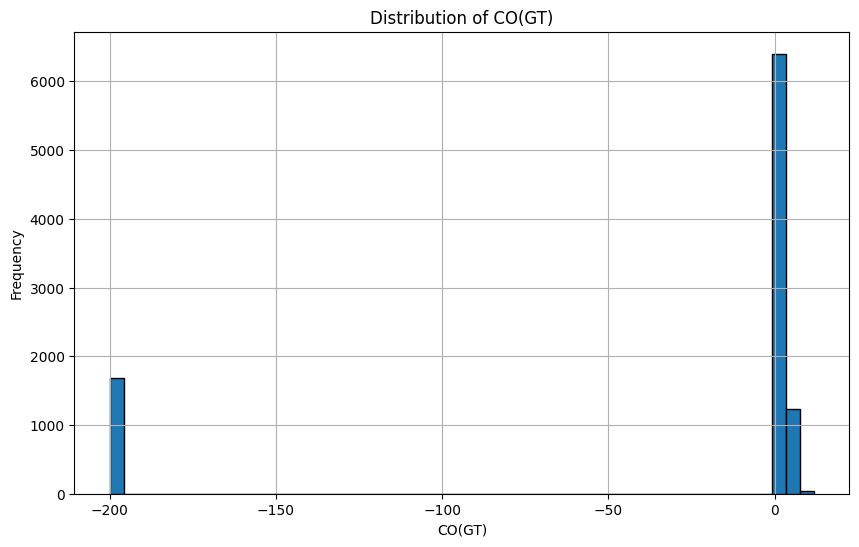

In [22]:
check_negative_value(co_df, 'CO(GT)')

In [23]:
clean_column(co_df, 'CO(GT)')
inspect_unclean_data(co_df, 'CO(GT)')

Checking for negative values in 'CO(GT)'.
Negative values found in 'CO(GT)'. Replacing with column mean.
Column 'CO(GT)' cleaned successfully.
Inspecting 'CO(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

Outliers detected:
                     NO2(GT)  NOx(GT)      T        AH  PT08.S1(CO)  CO(GT)
DateTime                                                                   
2004-03-11 19:00:00      172      383    9.7    0.8319         1776     6.9
2004-03-12 20:00:00      170      340   12.9    0.7478         1843     6.6
2004-03-15 09:00:00      149      478   14.8    0.9076         1961     8.1
2004-03-15 19:00:00      187      404   20.4    1.0086         2040     8.0
2004-03-15 20:00:00      165      320   18.3    1.0945         1895     6.5
2004-03-17 09:00:00      127      377   14.1    0.8020         1852     6.6
2004-03-17 19:00:00      194      411   23.1    0.7403         1973     7.6
2004-03-17 20:00:00      182  

<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)


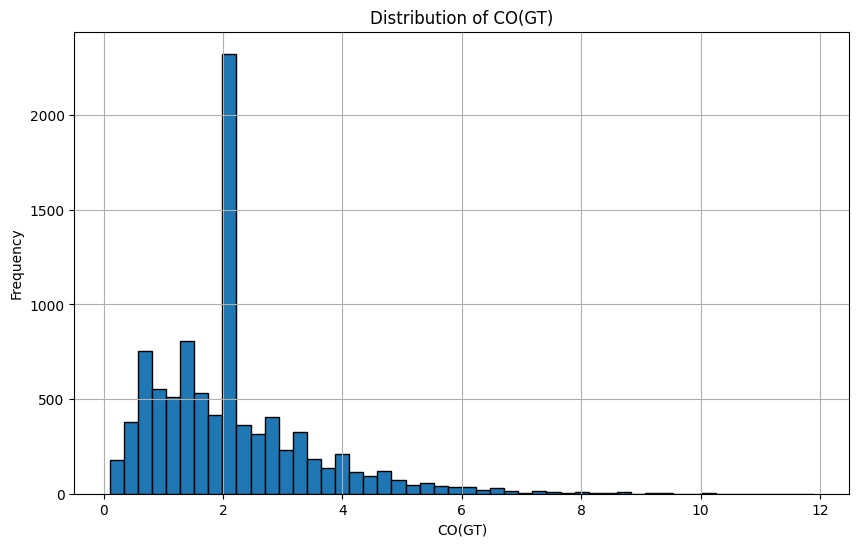

In [24]:
check_negative_value(co_df, 'CO(GT)')

In [25]:
inspect_unclean_data(co_df, 'NO2(GT)')

Inspecting 'NO2(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

No outliers detected.

Unique values (284 total): [ 113   92  114  122  116   96   77   76   60 -200]...

Inspection of 'NO2(GT)' completed.



In [26]:
for i in co_df.columns:
  print(i)

NO2(GT)
NOx(GT)
T
AH
PT08.S1(CO)
CO(GT)


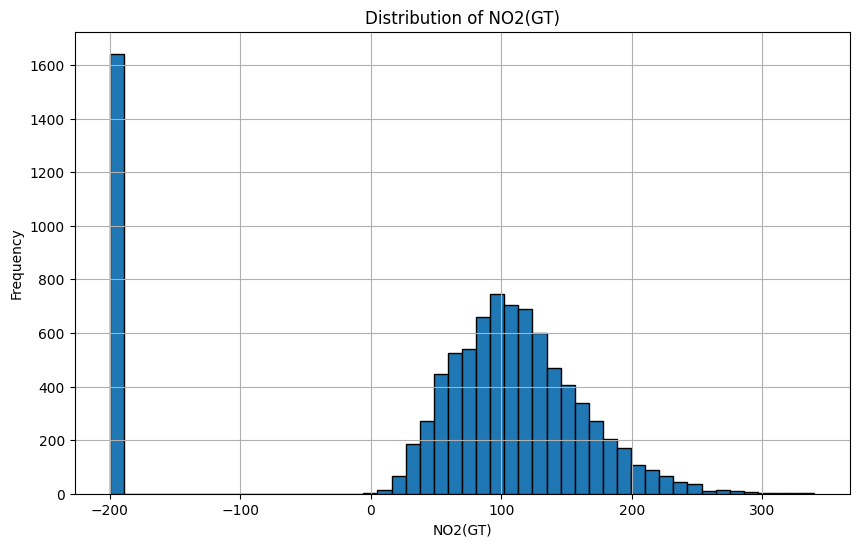

None


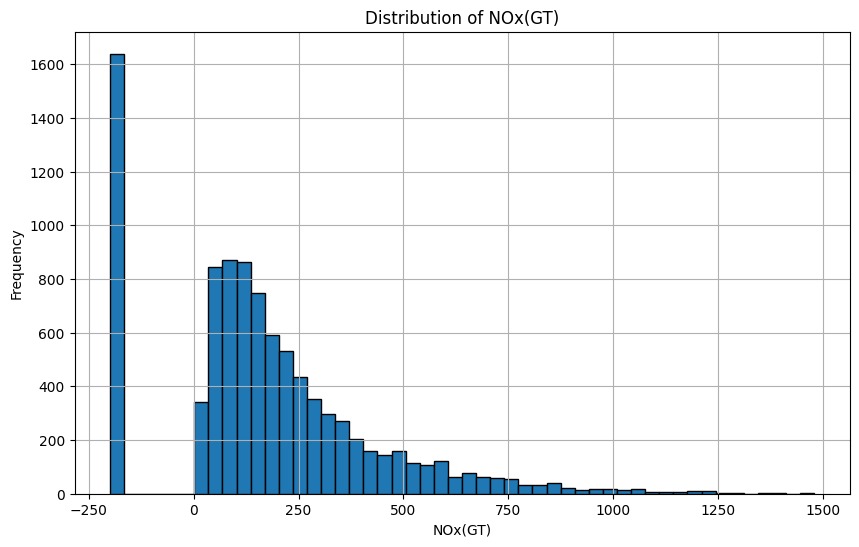

None


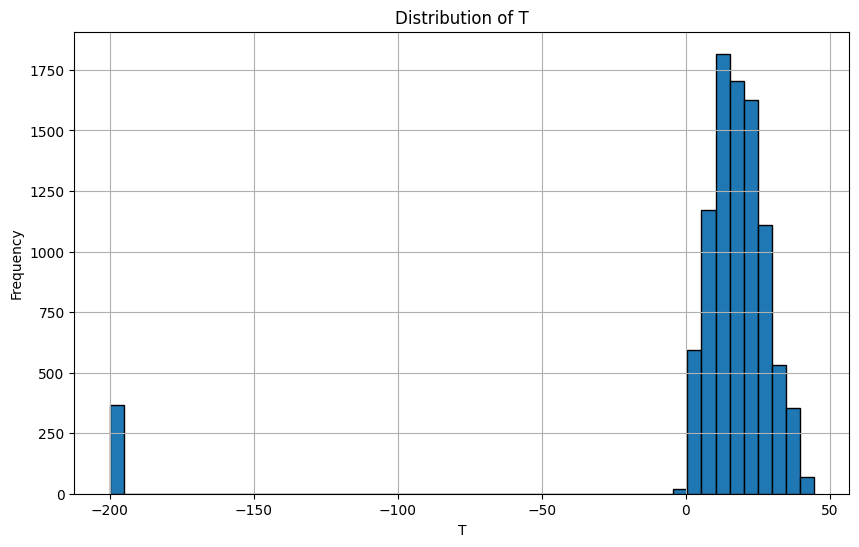

None


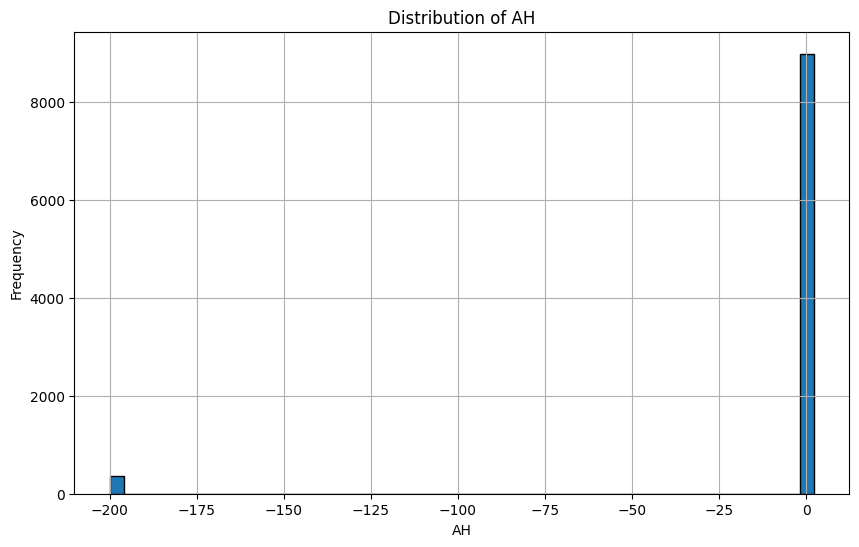

None


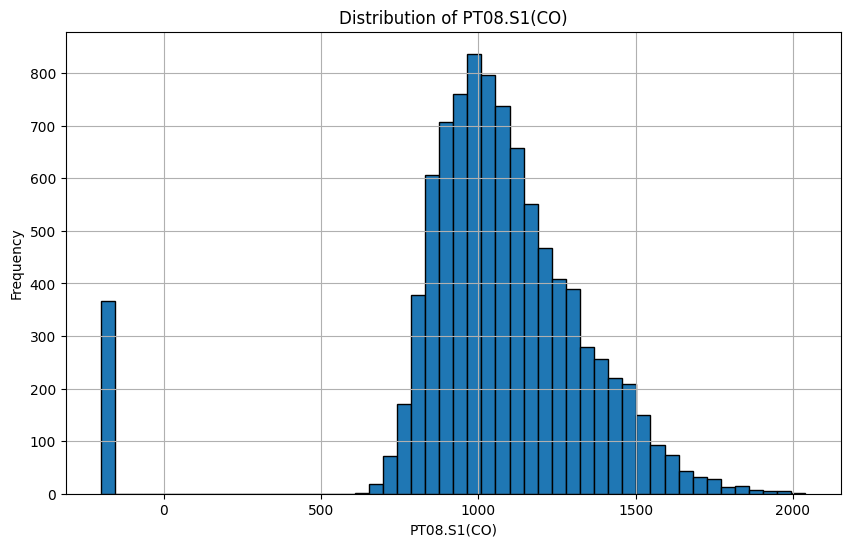

None


In [27]:
print(check_negative_value(co_df, 'NO2(GT)'))
print(check_negative_value(co_df, 'NOx(GT)'))
print(check_negative_value(co_df, 'T'))
print(check_negative_value(co_df, 'AH'))
print(check_negative_value(co_df, 'PT08.S1(CO)'))

In [28]:
for i in co_df.columns:
  print(i)
  if i!='CO(GT)':
    clean_column(co_df, i)
    inspect_unclean_data(co_df, i)

NO2(GT)
Checking for negative values in 'NO2(GT)'.
Negative values found in 'NO2(GT)'. Replacing with column mean.
Column 'NO2(GT)' cleaned successfully.
Inspecting 'NO2(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

Outliers detected:
                     NO2(GT)  NOx(GT)      T        AH  PT08.S1(CO)  CO(GT)
DateTime                                                                   
2004-11-17 17:00:00    272.0     1290   16.0    0.7483         1659     7.8
2004-11-17 19:00:00    288.0     1148   13.0    0.8240         1549     6.6
2004-11-17 20:00:00    254.0      729   12.4    0.8141         1407     4.3
2004-11-17 21:00:00    267.0      810   10.7    0.7972         1374     4.9
2004-11-18 09:00:00    249.0     1132    8.9    0.7714         1503     5.6
2004-11-18 10:00:00    282.0     1195   11.4    0.7868         1446     5.6
2004-11-18 11:00:00    278.0     1120   13.4    0.8086         1416     4.7
2004-11-18 12:00:0

<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)
<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)
<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = valu

NO2(GT)


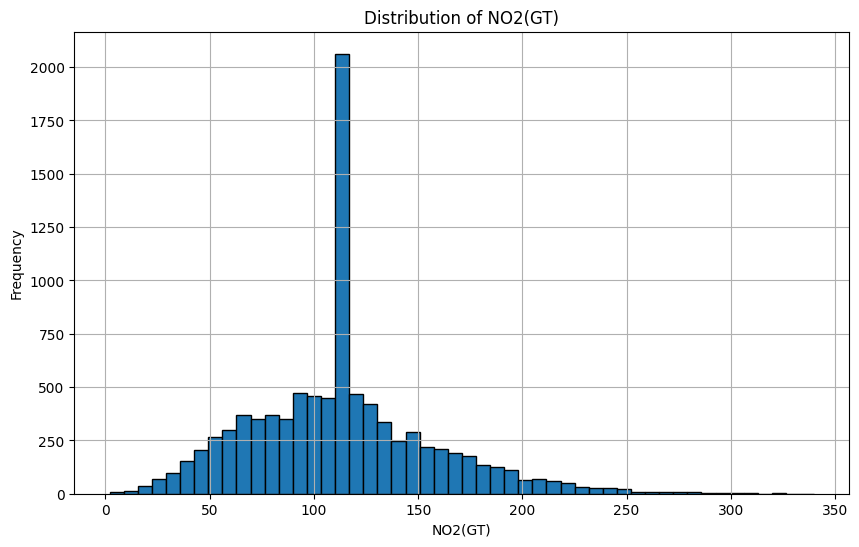

NOx(GT)


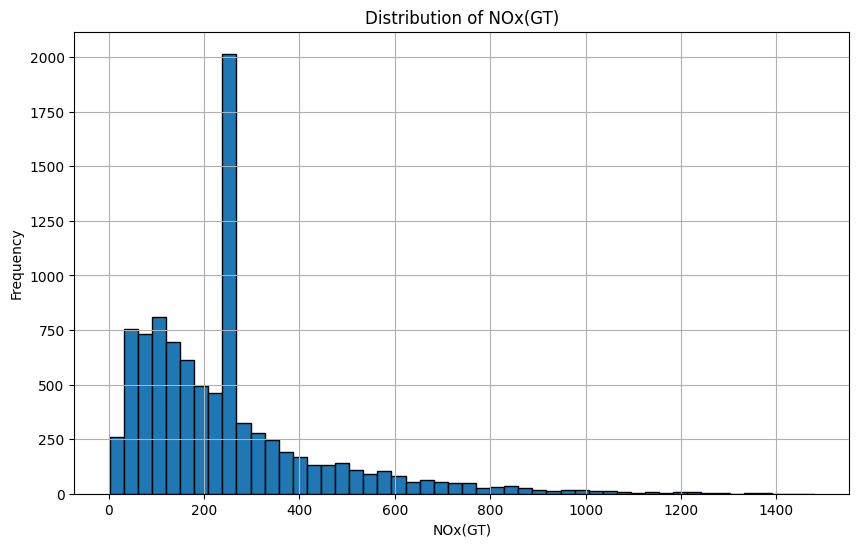

T


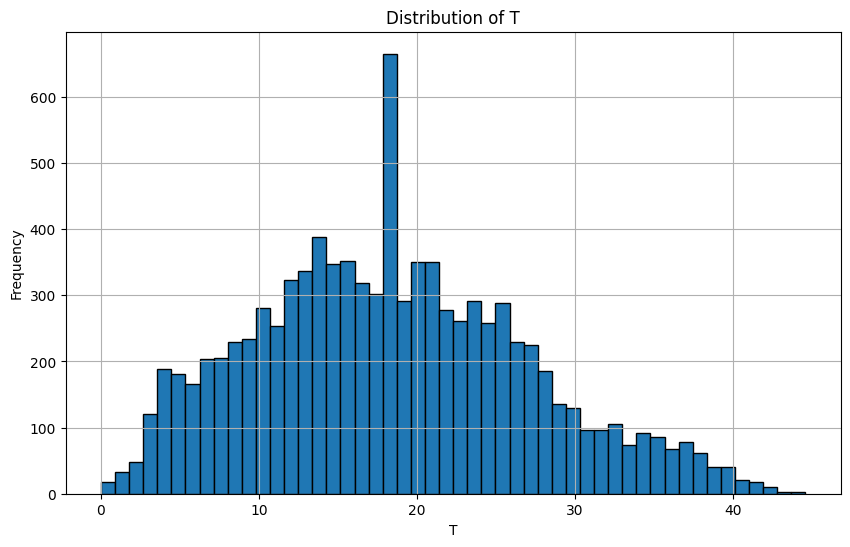

AH


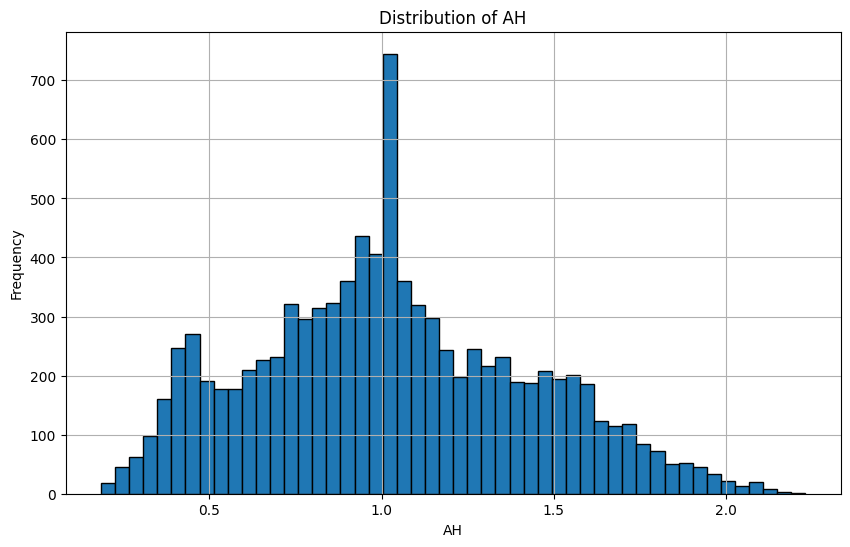

PT08.S1(CO)


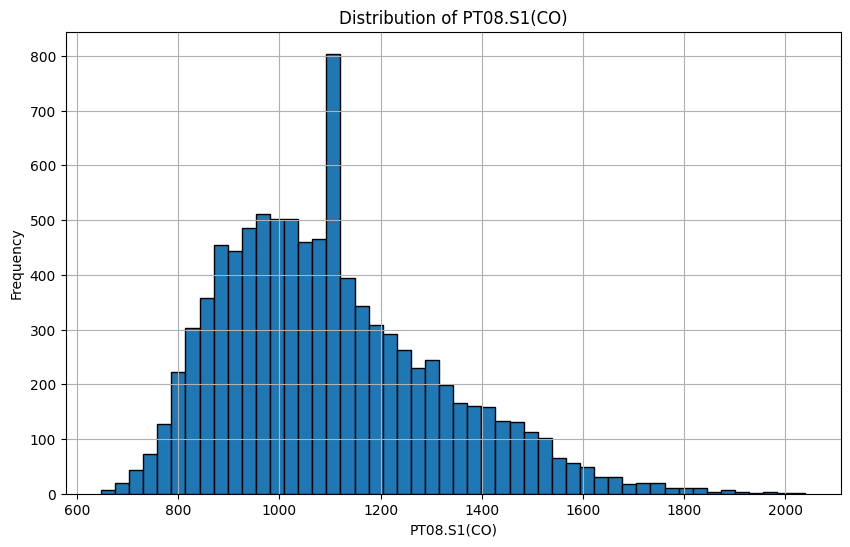

CO(GT)


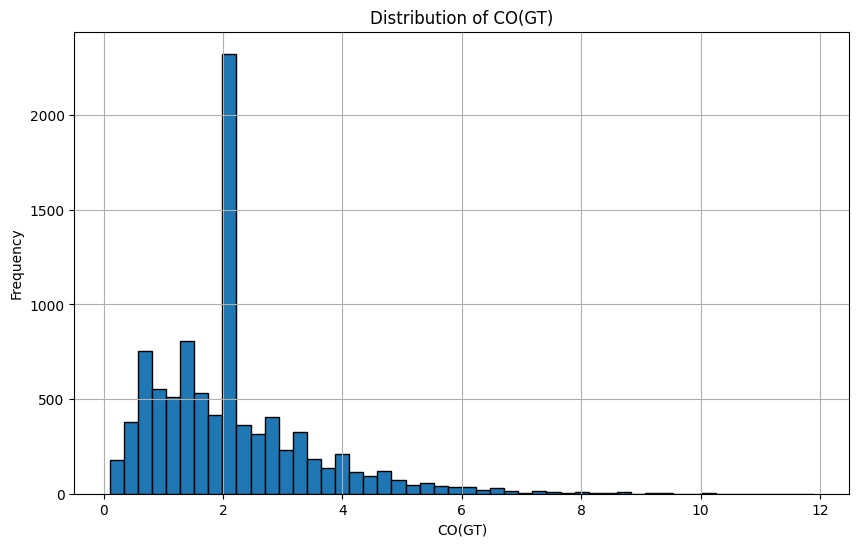

In [29]:
for i in co_df.columns:
  print(i)
  check_negative_value(co_df, i)

In [30]:
inspect_unclean_data(no2_df, 'NO2(GT)')

Inspecting 'NO2(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

No outliers detected.

Unique values (284 total): [ 113   92  114  122  116   96   77   76   60 -200]...

Inspection of 'NO2(GT)' completed.



In [31]:
clean_column(no2_df, 'NO2(GT)')
inspect_unclean_data(no2_df, 'NO2(GT)')

Checking for negative values in 'NO2(GT)'.
Negative values found in 'NO2(GT)'. Replacing with column mean.
Column 'NO2(GT)' cleaned successfully.
Inspecting 'NO2(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

Outliers detected:
                     NOx(GT)  PT08.S4(NO2)      T     RH  NO2(GT)
DateTime                                                         
2004-11-17 17:00:00     1290          1946   16.0   41.5    272.0
2004-11-17 19:00:00     1148          1796   13.0   55.1    288.0
2004-11-17 20:00:00      729          1557   12.4   56.8    254.0
2004-11-17 21:00:00      810          1531   10.7   62.1    267.0
2004-11-18 09:00:00     1132          1749    8.9   67.4    249.0
2004-11-18 10:00:00     1195          1560   11.4   58.3    282.0
2004-11-18 11:00:00     1120          1471   13.4   52.8    278.0
2004-11-18 12:00:00      870          1506   15.8   50.1    251.0
2004-11-22 19:00:00     1345          1881    9.1 

<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)


In [32]:
for i in no2_df.columns:
  print(i)
  if i!='NO2(GT)':
    clean_column(no2_df, i)
    inspect_unclean_data(no2_df, i)

NOx(GT)
Checking for negative values in 'NOx(GT)'.
Negative values found in 'NOx(GT)'. Replacing with column mean.
Column 'NOx(GT)' cleaned successfully.
Inspecting 'NOx(GT)' for unclean data...

Missing values: 0

No invalid patterns detected.

No non-numeric values detected.

Outliers detected:
                     NOx(GT)  PT08.S4(NO2)      T     RH  NO2(GT)
DateTime                                                         
2004-09-13 21:00:00    891.0          1883   26.1   46.4    172.0
2004-10-20 17:00:00    895.0          2595   24.6   58.9    194.0
2004-10-25 18:00:00    860.0          2567   21.0   64.9    149.0
2004-10-26 17:00:00    918.0          2641   23.2   58.7    187.0
2004-10-26 18:00:00    952.0          2775   22.5   61.5    180.0
2004-11-02 11:00:00    844.0          2170   22.1   56.6    151.0
2004-11-02 20:00:00    859.0          2643   20.9   67.5    119.0
2004-11-04 17:00:00   1052.0          2603   24.8   53.9    186.0
2004-11-04 18:00:00   1014.0          2609

<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)
<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[column_name] = new_df[column_name].apply(lambda x: x if x >= 0 else mean_value)
<ipython-input-12-c0aa6f2322e0>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = valu

In [33]:
print(co_df.columns)
print(no2_df.columns)

Index(['NO2(GT)', 'NOx(GT)', 'T', 'AH', 'PT08.S1(CO)', 'CO(GT)'], dtype='object')
Index(['NOx(GT)', 'PT08.S4(NO2)', 'T', 'RH', 'NO2(GT)'], dtype='object')


In [34]:
for i in co_df.select_dtypes(include=np.number).columns:
    print(f'Column: {i}')
    co_df[i].describe()
    upper_limit = co_df[i].quantile(0.75) + 1.5*( co_df[i].quantile(0.75) - co_df[i].quantile(0.25))
    lower_limit = co_df[i].quantile(0.75) - 1.5*( co_df[i].quantile(0.75) - co_df[i].quantile(0.25))

    co_df[i] = np.where(co_df[i] > upper_limit, upper_limit, np.where(co_df[i] < lower_limit, lower_limit, co_df[i]))


for i in no2_df.select_dtypes(include=np.number).columns:
    print(f'Column: {i}')
    no2_df[i].describe()
    upper_limit = no2_df[i].quantile(0.75) + 1.5*( no2_df[i].quantile(0.75) - no2_df[i].quantile(0.25))
    lower_limit = no2_df[i].quantile(0.75) - 1.5*( no2_df[i].quantile(0.75) - no2_df[i].quantile(0.25))

    no2_df[i] = np.where(no2_df[i] > upper_limit, upper_limit, np.where(no2_df[i] < lower_limit, lower_limit, no2_df[i]))

Column: NO2(GT)
Column: NOx(GT)
Column: T
Column: AH
Column: PT08.S1(CO)
Column: CO(GT)
Column: NOx(GT)
Column: PT08.S4(NO2)
Column: T
Column: RH
Column: NO2(GT)


<ipython-input-34-ce011eae7a4b>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  co_df[i] = np.where(co_df[i] > upper_limit, upper_limit, np.where(co_df[i] < lower_limit, lower_limit, co_df[i]))
<ipython-input-34-ce011eae7a4b>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  co_df[i] = np.where(co_df[i] > upper_limit, upper_limit, np.where(co_df[i] < lower_limit, lower_limit, co_df[i]))
<ipython-input-34-ce011eae7a4b>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

In [35]:
for i in co_df.select_dtypes(include=np.number).columns:
    print(f'Column: {i}')
    upper_limit = co_df[i].mean() + 3*co_df[i].std()
    lower_limit = co_df[i].mean() - 3*co_df[i].std()

    co_df[i] = np.where(co_df[i] > upper_limit, upper_limit, np.where(co_df[i] < lower_limit, lower_limit, co_df[i]))


for i in no2_df.select_dtypes(include=np.number).columns:
    print(f'Column: {i}')
    upper_limit = no2_df[i].mean() + 3*no2_df[i].std()
    lower_limit = no2_df[i].mean() - 3*no2_df[i].std()

    no2_df[i] = np.where(no2_df[i] > upper_limit, upper_limit, np.where(no2_df[i] < lower_limit, lower_limit, no2_df[i]))

<ipython-input-35-47512e51c558>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  co_df[i] = np.where(co_df[i] > upper_limit, upper_limit, np.where(co_df[i] < lower_limit, lower_limit, co_df[i]))


Column: NO2(GT)
Column: NOx(GT)
Column: T
Column: AH
Column: PT08.S1(CO)
Column: CO(GT)
Column: NOx(GT)
Column: PT08.S4(NO2)
Column: T
Column: RH
Column: NO2(GT)


<ipython-input-35-47512e51c558>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no2_df[i] = np.where(no2_df[i] > upper_limit, upper_limit, np.where(no2_df[i] < lower_limit, lower_limit, no2_df[i]))


### 2. Exploratory Data Analysis (EDA)
- **Trend Analysis**:
  - Visualize the long-term trends of `CO(GT)` and `NO₂(GT)`.
- **Seasonality**:
  - Identify seasonal patterns (e.g., daily or yearly fluctuations).
- **Correlation Analysis**:
  - Explore relationships between `CO(GT)`, `NO₂(GT)`, and other features (e.g., temperature or humidity).


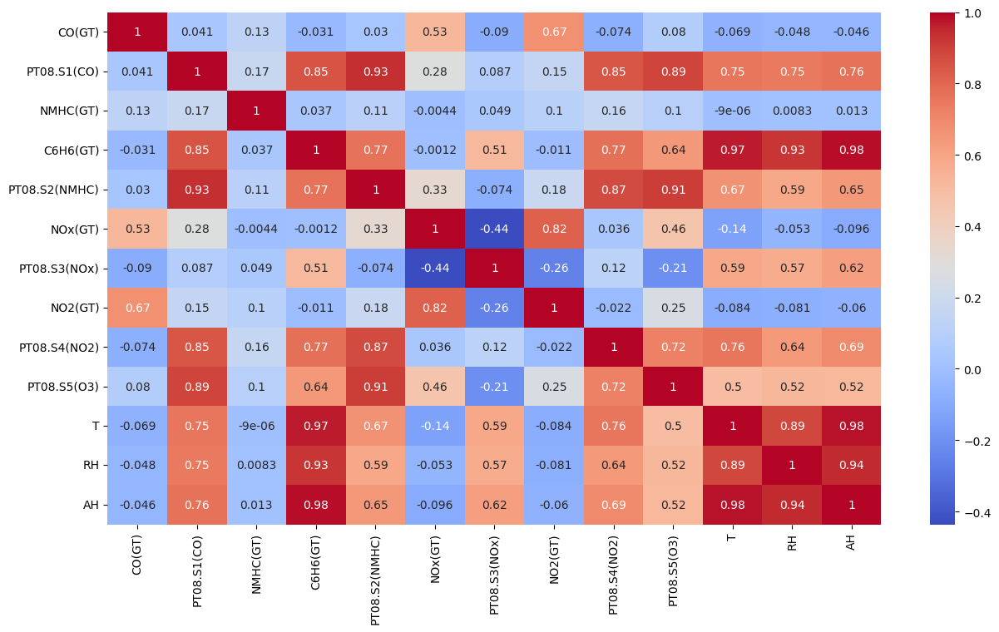

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 8))
corr = new_df.select_dtypes(include=['number']).corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()

#### CO DATASETS

In [37]:
co_df.head()

,NO2(GT),NOx(GT),T,AH,PT08.S1(CO),CO(GT)
DateTime,,,,,,
2004-03-10 18:00:00,113.0,166.0,13.6,0.7578,1360.0,2.6
2004-03-10 19:00:00,92.0,103.0,13.3,0.7255,1292.0,2.0
2004-03-10 20:00:00,114.0,131.0,11.9,0.7502,1402.0,2.2
2004-03-10 21:00:00,122.0,172.0,11.0,0.7867,1376.0,2.2
2004-03-10 22:00:00,116.0,131.0,11.2,0.7888,1272.0,1.6


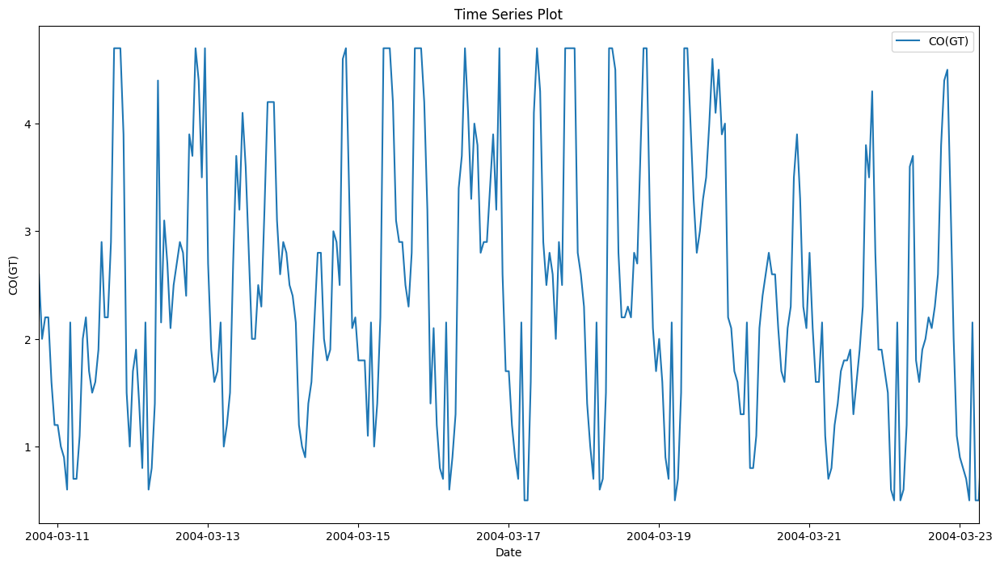

In [38]:
plt.figure(figsize=(15, 8))
plt.plot(co_df.index, co_df['CO(GT)'], label='CO(GT)')
plt.title('Time Series Plot')
plt.xlabel('Date')
plt.ylabel('CO(GT)')
plt.legend()

# print(co_df.index)
# Set x-axis limits
plt.xlim(co_df.index[0], co_df.index[300])

plt.show()


<Axes: xlabel='DateTime'>

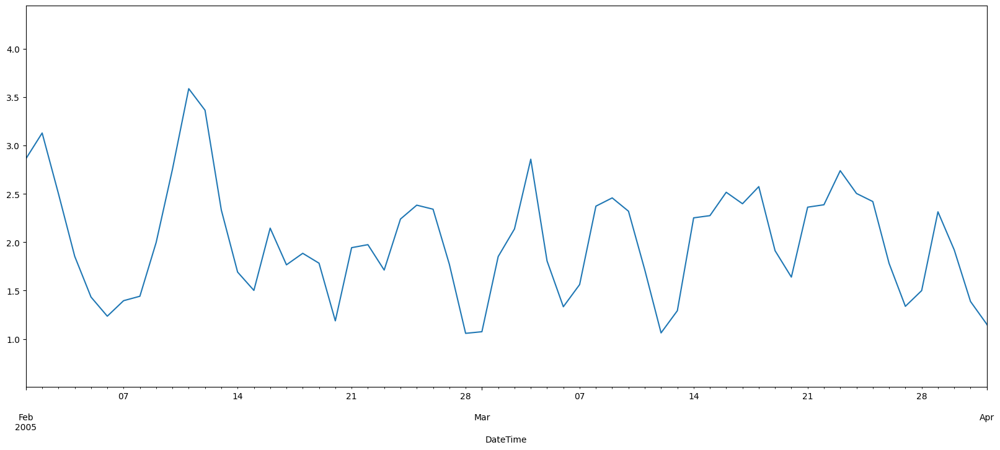

In [39]:
co_df['CO(GT)'].resample(rule='D').mean().plot(figsize=(20,8),xlim=['2005-02-01', '2005-04-01'])

<Axes: xlabel='DateTime'>

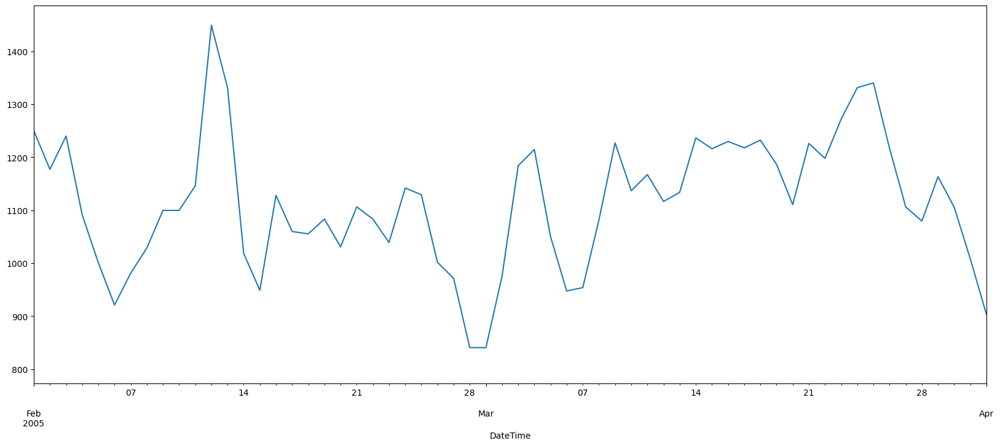

In [40]:
co_df['PT08.S1(CO)'].resample(rule='D').mean().plot(figsize=(20,8),xlim=['2005-02-01', '2005-04-01'])

####NO2 DATASETS

In [41]:
no2_df.head()

,NOx(GT),PT08.S4(NO2),T,RH,NO2(GT)
DateTime,,,,,
2004-03-10 18:00:00,166.0,1692.0,13.6,48.9,113.0
2004-03-10 19:00:00,103.0,1559.0,13.3,47.7,92.0
2004-03-10 20:00:00,131.0,1555.0,11.9,54.0,114.0
2004-03-10 21:00:00,172.0,1584.0,11.0,60.0,122.0
2004-03-10 22:00:00,131.0,1490.0,11.2,59.6,116.0


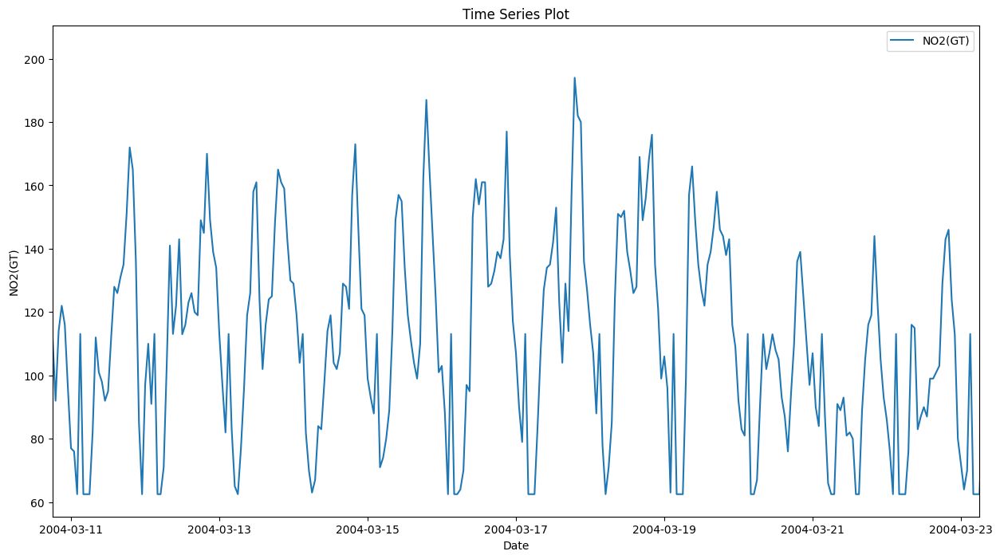

In [42]:
plt.figure(figsize=(15, 8))
plt.plot(no2_df.index, no2_df['NO2(GT)'], label='NO2(GT)')
plt.title('Time Series Plot')
plt.xlabel('Date')
plt.ylabel('NO2(GT)')
plt.legend()

# print(co_df.index)
# Set x-axis limits
plt.xlim(no2_df.index[0], no2_df.index[300])

plt.show()



### 3. Feature Engineering
- Create lag features for `CO(GT)` and `NO₂(GT)` to incorporate historical values.
- Add time-based features (e.g., hour of the day, day of the week, month).
- Include environmental factors (`T`, `RH`, `AH`) as predictors.


####CO DATASETS

In [43]:
co_df.columns

Index(['NO2(GT)', 'NOx(GT)', 'T', 'AH', 'PT08.S1(CO)', 'CO(GT)'], dtype='object')

In [44]:
for i in co_df.columns:
  co_df[f'{i}_lag_1'] = co_df[i].shift(2)
  # co_df.loc[f'{i}_lag_2'] = co_df[i].shift(2)

<ipython-input-44-1fbb16de4ab1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  co_df[f'{i}_lag_1'] = co_df[i].shift(2)
<ipython-input-44-1fbb16de4ab1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  co_df[f'{i}_lag_1'] = co_df[i].shift(2)
<ipython-input-44-1fbb16de4ab1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/use

In [45]:
co_df

,NO2(GT),NOx(GT),T,AH,PT08.S1(CO),CO(GT),NO2(GT)_lag_1,NOx(GT)_lag_1,T_lag_1,AH_lag_1,PT08.S1(CO)_lag_1,CO(GT)_lag_1
DateTime,,,,,,,,,,,,
2004-03-10 18:00:00,113.000000,166.000000,13.600000,0.75780,1360.000000,2.60000,NaN,NaN,NaN,NaN,NaN,NaN
2004-03-10 19:00:00,92.000000,103.000000,13.300000,0.72550,1292.000000,2.00000,NaN,NaN,NaN,NaN,NaN,NaN
2004-03-10 20:00:00,114.000000,131.000000,11.900000,0.75020,1402.000000,2.20000,113.000000,166.000000,13.600000,0.75780,1360.000000,2.60000
2004-03-10 21:00:00,122.000000,172.000000,11.000000,0.78670,1376.000000,2.20000,92.000000,103.000000,13.300000,0.72550,1292.000000,2.00000
2004-03-10 22:00:00,116.000000,131.000000,11.200000,0.78880,1272.000000,1.60000,114.000000,131.000000,11.900000,0.75020,1402.000000,2.20000
2004-03-10 23:00:00,96.000000,89.000000,11.200000,0.78480,1197.000000,1.20000,122.000000,172.000000,11.000000,0.78670,1376.000000,2.20000
2004-03-11 00:00:00,77.000000,62.000000,11.300000,0.76030,1185.000000,1.20000,116.000000,131.000000,11.200000,0.78880,1272.000000,1.60000
2004-03-11 01:00:00,76.000000,62.000000,10.700000,0.77020,1136.000000,1.00000,96.000000,89.000000,11.200000,0.78480,1197.000000,1.20000
2004-03-11 02:00:00,62.500000,45.000000,10.700000,0.76480,1094.000000,0.90000,77.000000,62.000000,11.300000,0.76030,1185.000000,1.20000


In [46]:
co_df = co_df.drop(co_df.index[0:2])  # Drop the first row

In [47]:
co_df = co_df.resample('h').mean()
# Iterate over each column in the DataFrame to perform the ADF test
for column in ['NO2(GT)_lag_1',	'NOx(GT)_lag_1'	,'T_lag_1',	'AH_lag_1',	'PT08.S1(CO)_lag_1']:
    result = adfuller(co_df[column])  # Apply ADF test to individual column
    print(f"ADF Test for {column}:")
    print("ADF Statistic:", result[0])
    print("p-value:", result[1])

    if result[1] > 0.05:
        print("The series is not stationary. Differencing will be applied.")
        # Apply differencing to the individual column
        co_df[f'{column}_log'] = co_df[column].diff().dropna()
    else:
        print("The series is stationary. Proceeding without differencing.")

ADF Test for NO2(GT)_lag_1:
ADF Statistic: -7.791329504053521
p-value: 7.927429582735756e-12
The series is stationary. Proceeding without differencing.
ADF Test for NOx(GT)_lag_1:
ADF Statistic: -7.122103364918942
p-value: 3.699663746938419e-10
The series is stationary. Proceeding without differencing.
ADF Test for T_lag_1:
ADF Statistic: -3.669203365253236
p-value: 0.004567790989831454
The series is stationary. Proceeding without differencing.
ADF Test for AH_lag_1:
ADF Statistic: -5.495624952365016
p-value: 2.126713886054379e-06
The series is stationary. Proceeding without differencing.
ADF Test for PT08.S1(CO)_lag_1:
ADF Statistic: -10.052393730794194
p-value: 1.4013847994607713e-17
The series is stationary. Proceeding without differencing.


In [48]:
co_df.head()

,NO2(GT),NOx(GT),T,AH,PT08.S1(CO),CO(GT),NO2(GT)_lag_1,NOx(GT)_lag_1,T_lag_1,AH_lag_1,PT08.S1(CO)_lag_1,CO(GT)_lag_1
DateTime,,,,,,,,,,,,
2004-03-10 20:00:00,114.0,131.0,11.9,0.7502,1402.0,2.2,113.0,166.0,13.6,0.7578,1360.0,2.6
2004-03-10 21:00:00,122.0,172.0,11.0,0.7867,1376.0,2.2,92.0,103.0,13.3,0.7255,1292.0,2.0
2004-03-10 22:00:00,116.0,131.0,11.2,0.7888,1272.0,1.6,114.0,131.0,11.9,0.7502,1402.0,2.2
2004-03-10 23:00:00,96.0,89.0,11.2,0.7848,1197.0,1.2,122.0,172.0,11.0,0.7867,1376.0,2.2
2004-03-11 00:00:00,77.0,62.0,11.3,0.7603,1185.0,1.2,116.0,131.0,11.2,0.7888,1272.0,1.6


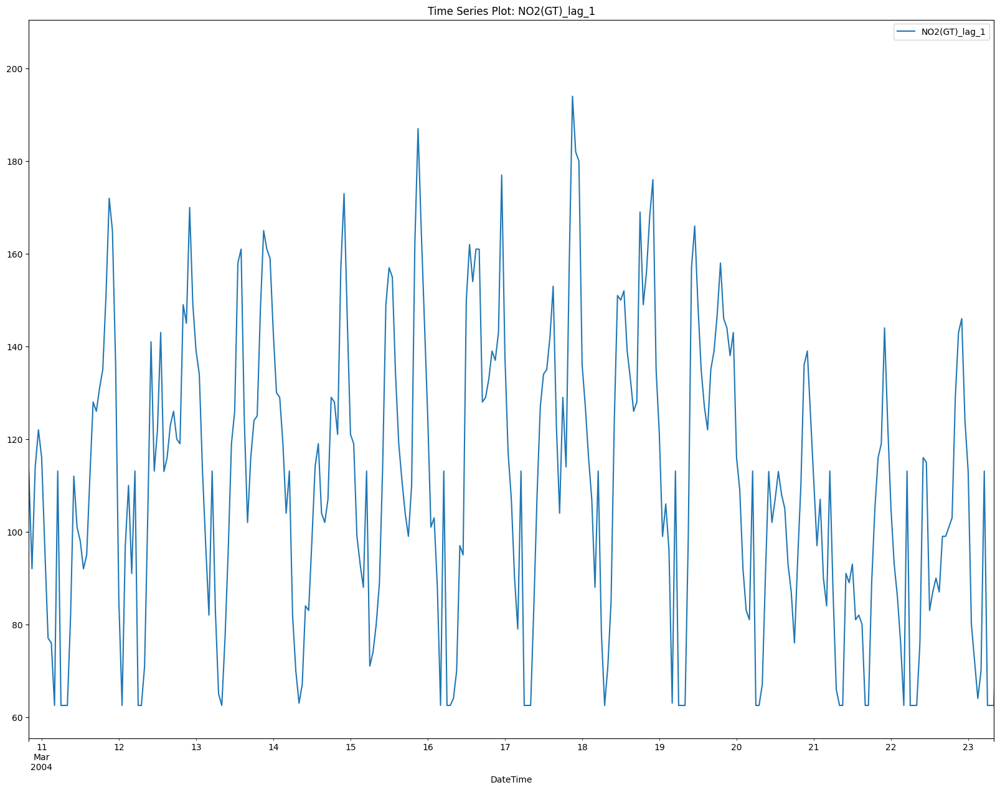

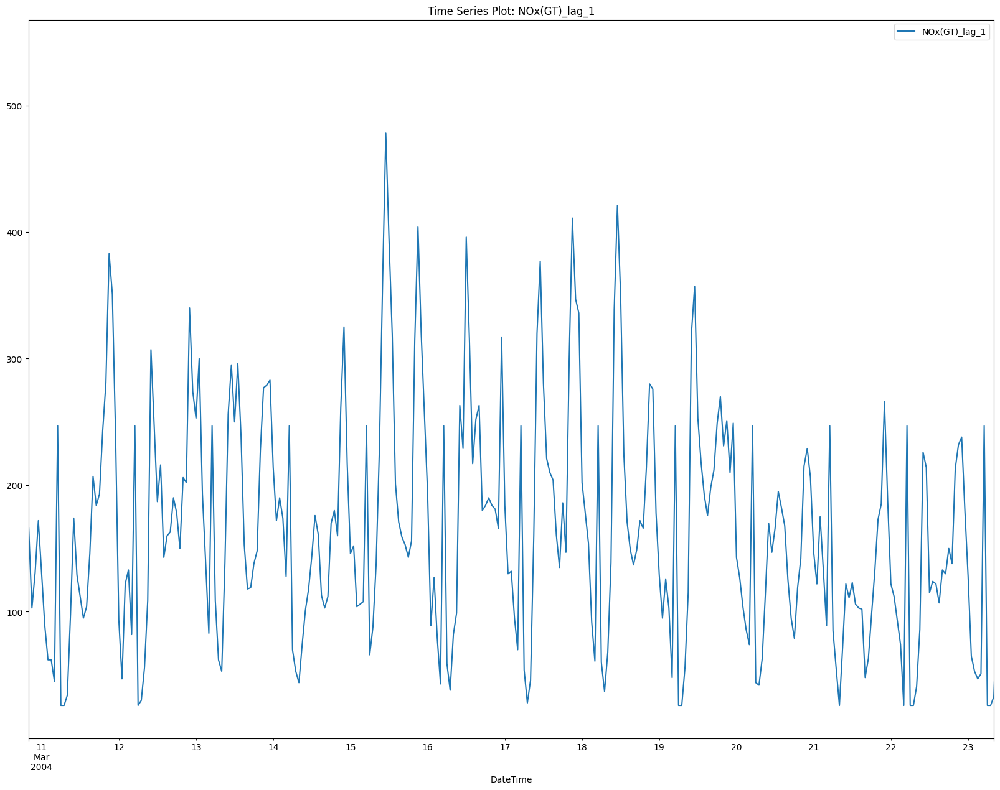

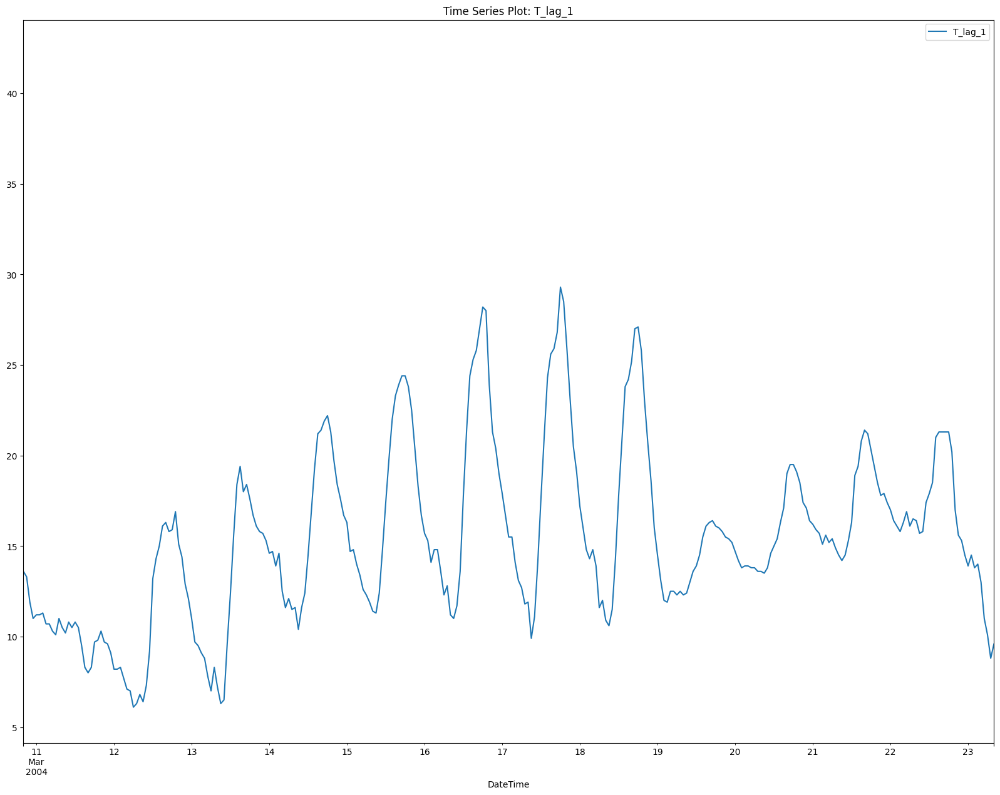

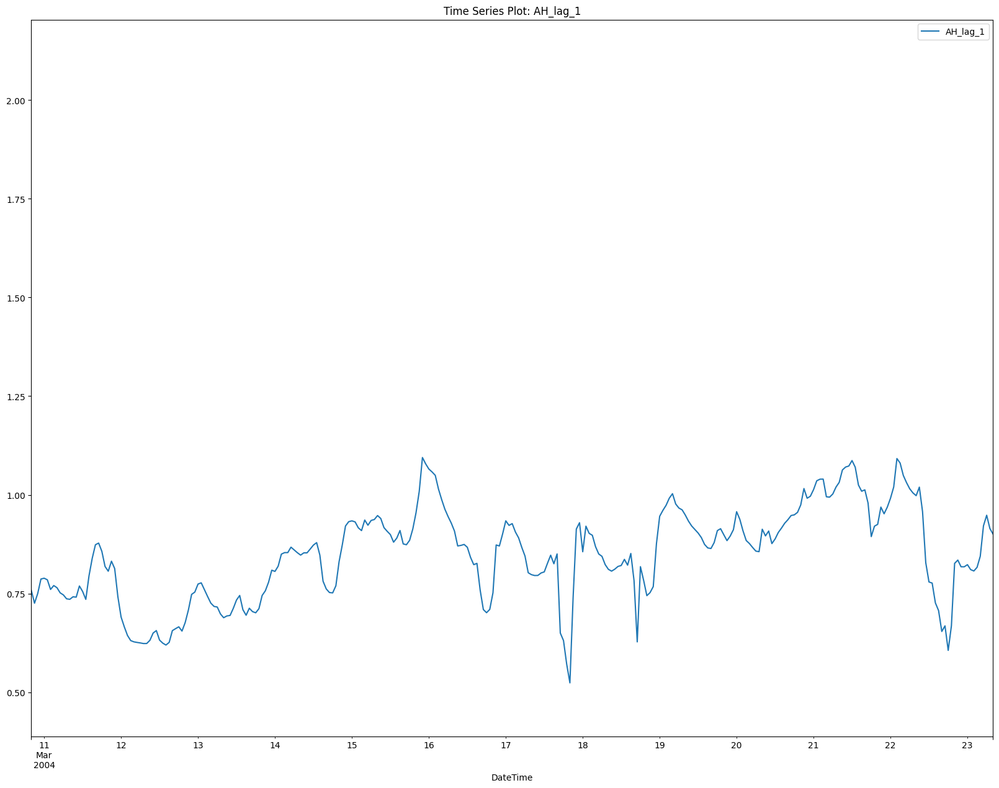

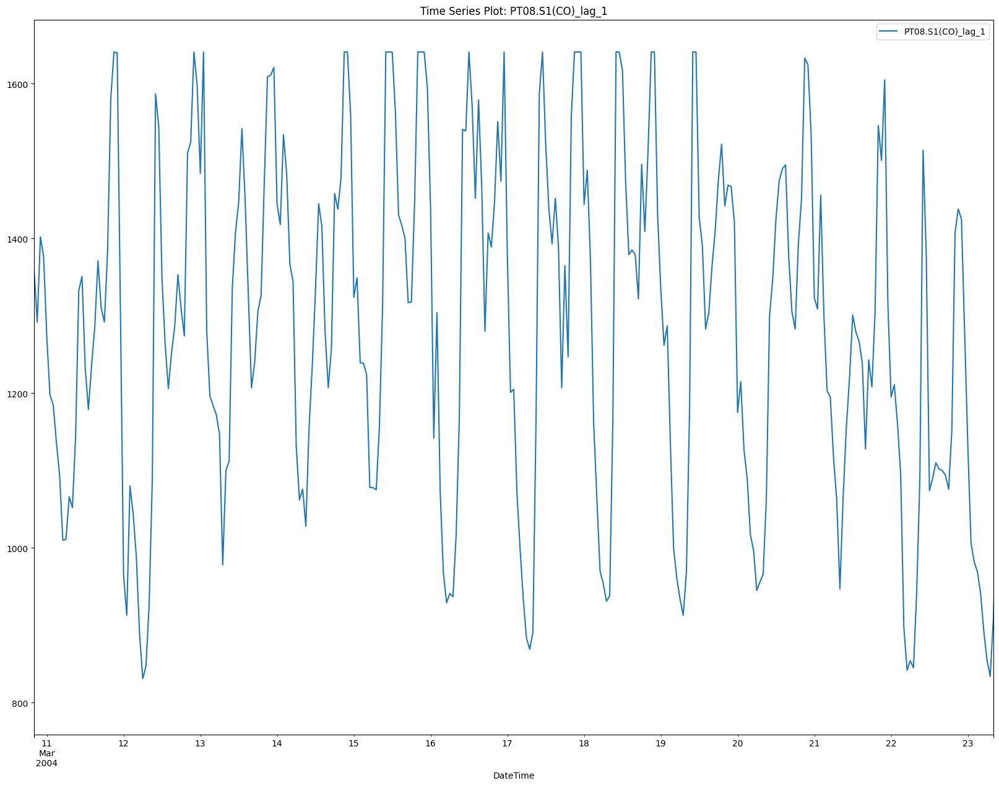

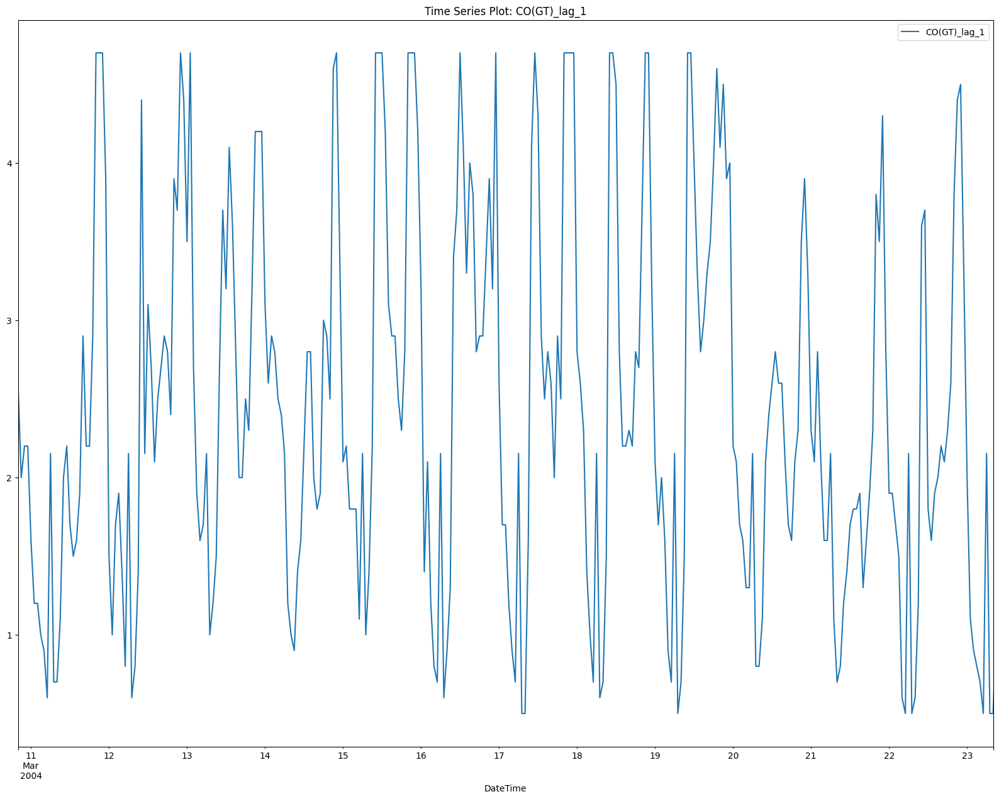

In [49]:
for column in ['NO2(GT)_lag_1', 'NOx(GT)_lag_1', 'T_lag_1', 'AH_lag_1', 'PT08.S1(CO)_lag_1', 'CO(GT)_lag_1']:
    co_df[column].plot(title=f"Time Series Plot: {column}", figsize=(20, 15), xlim=[co_df.index[0],co_df.index[300]])
    plt.legend()
    plt.show()


In [50]:
for column in ['NO2(GT)_lag_1', 'NOx(GT)_lag_1', 'T_lag_1', 'AH_lag_1', 'PT08.S1(CO)_lag_1', 'CO(GT)_lag_1']:
  co_df[f'{column}_lag_1_diff'] = co_df[column].diff(periods=12)

In [51]:
co_df.columns

Index(['NO2(GT)', 'NOx(GT)', 'T', 'AH', 'PT08.S1(CO)', 'CO(GT)', 'NO2(GT)_lag_1', 'NOx(GT)_lag_1',
       'T_lag_1', 'AH_lag_1', 'PT08.S1(CO)_lag_1', 'CO(GT)_lag_1', 'NO2(GT)_lag_1_lag_1_diff',
       'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff',
       'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff'],
      dtype='object')

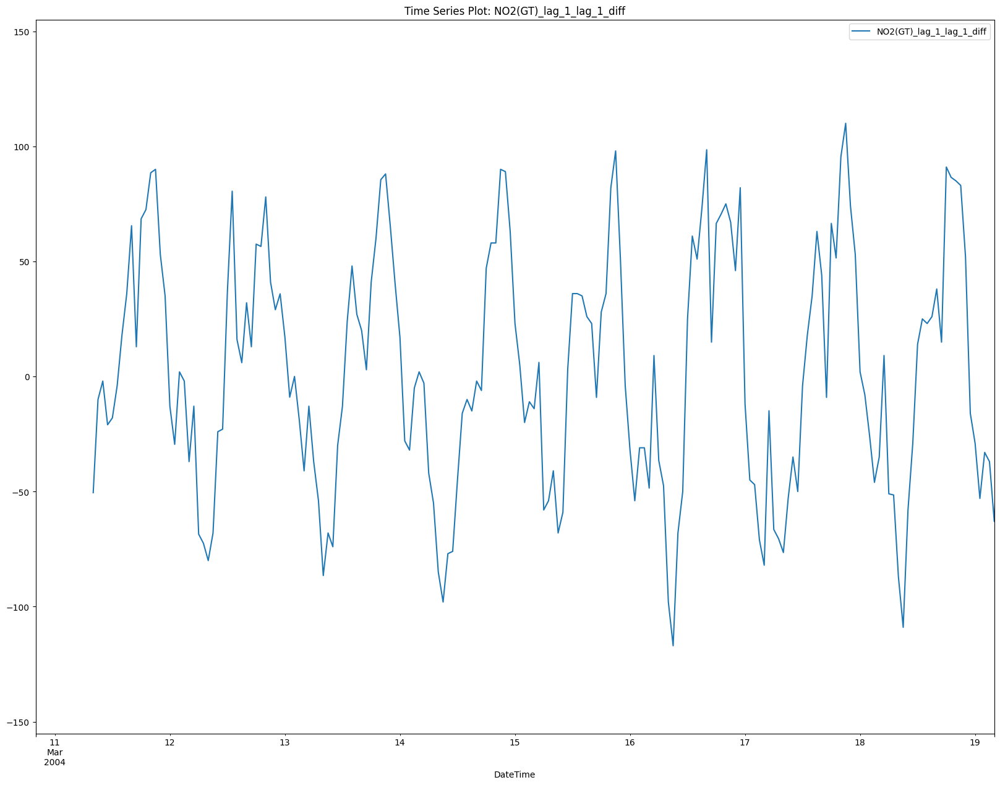

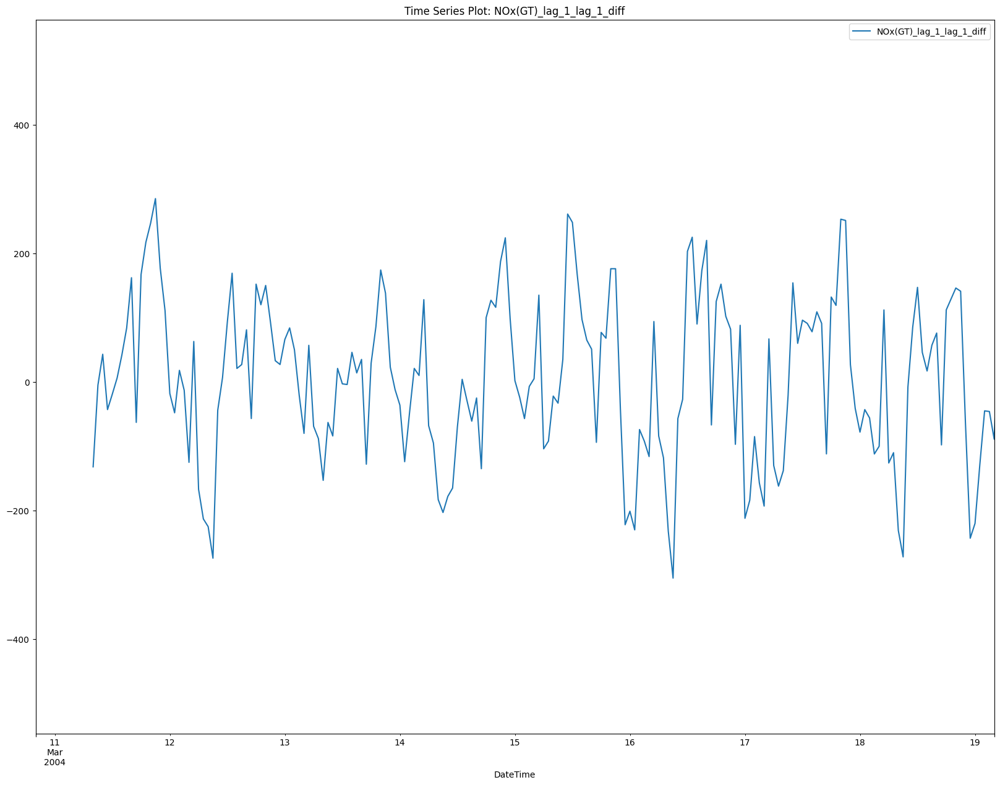

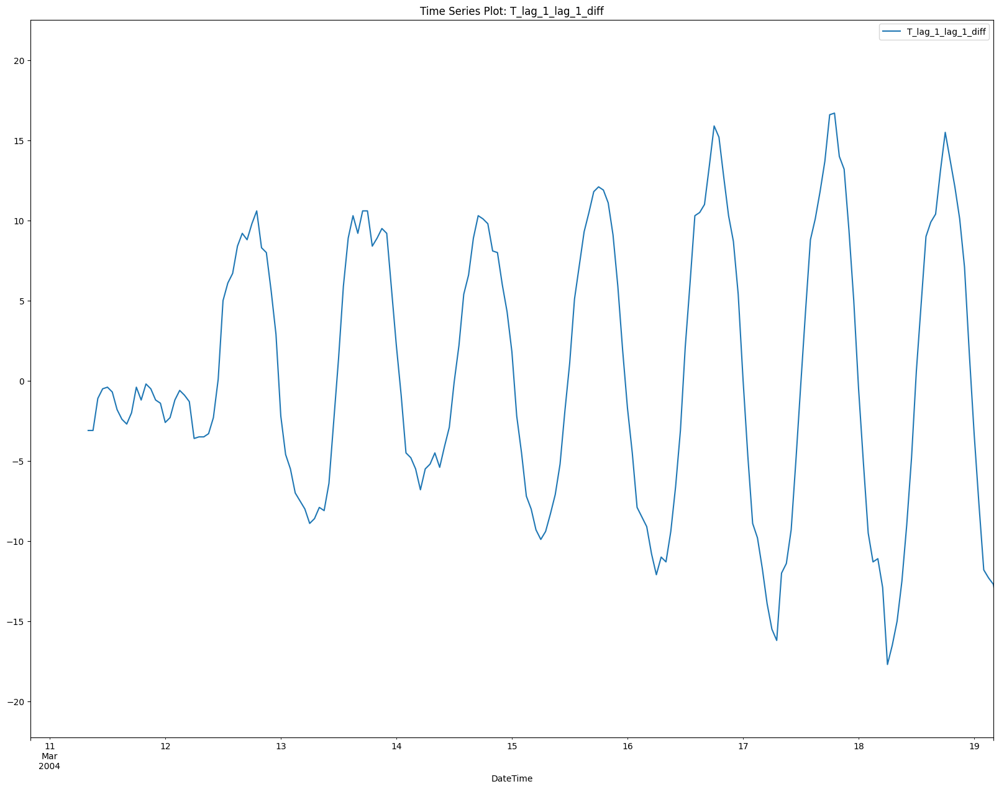

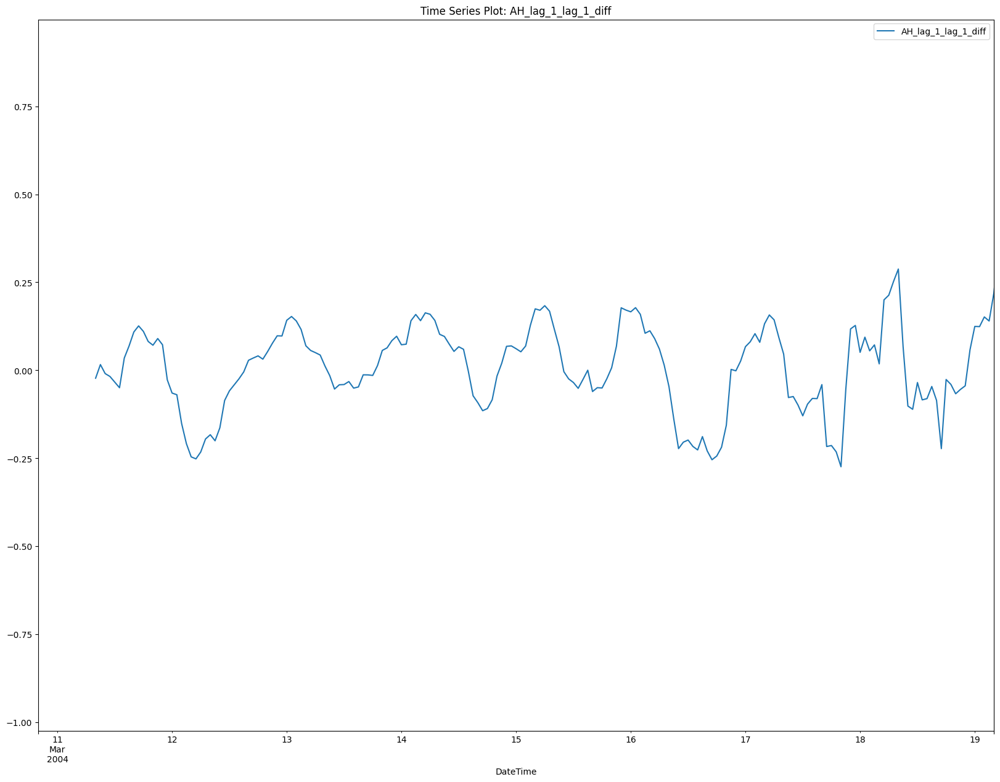

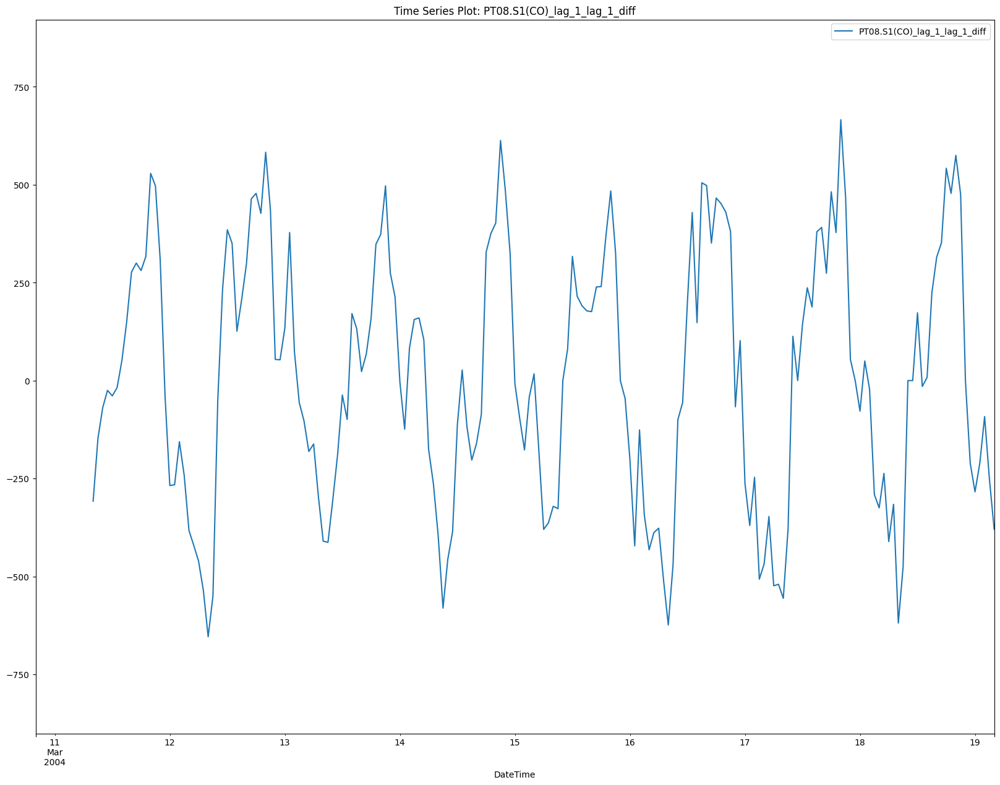

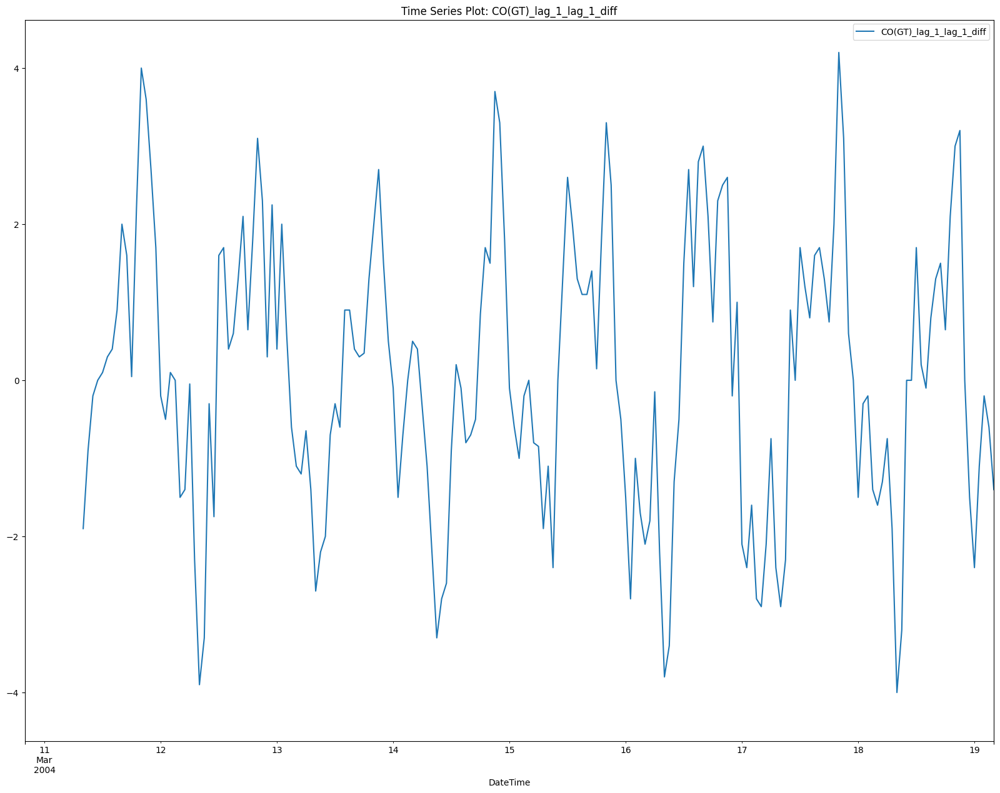

In [52]:
for column in ['NO2(GT)_lag_1_lag_1_diff', 'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff', 'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff']:
  co_df[column].plot(title=f"Time Series Plot: {column}", figsize=(20, 15), xlim=[co_df.index[0],co_df.index[200]])
  plt.legend()
  plt.show()


In [53]:
# from statsmodels.tsa.seasonal import seasonal_decompose
# for column in ['NO2(GT)_lag_1_lag_1_diff', 'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff', 'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff']:
#   decomposition = seasonal_decompose(co_df[column].dropna(), model='additive', period=12)
#   decomposition.plot()
#   co_df[f'{column}_detrended'] = co_df[column] - decomposition.trend



In [54]:
# from statsmodels.tsa.stattools import adfuller
# for column in ['NO2(GT)_lag_1_lag_1_diff', 'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff', 'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff']:
#   result = adfuller(co_df[f'{column}_detrended'].dropna())
#   print(f"ADF Test p-value for {column}: {result[1]}")
#   if result[1] > 0.05:
#       print("The series is still not stationary.")
#   else:
#       print("The series is now stationary.")


Processing column: NO2(GT)_lag_1_lag_1_diff
NO2(GT)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: NOx(GT)_lag_1_lag_1_diff
NOx(GT)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: T_lag_1_lag_1_diff
T_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: AH_lag_1_lag_1_diff
AH_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: PT08.S1(CO)_lag_1_lag_1_diff
PT08.S1(CO)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: CO(GT)_lag_1_lag_1_diff
CO(GT)_lag_1_lag_1_diff: Data is stationary and ready for modeling.


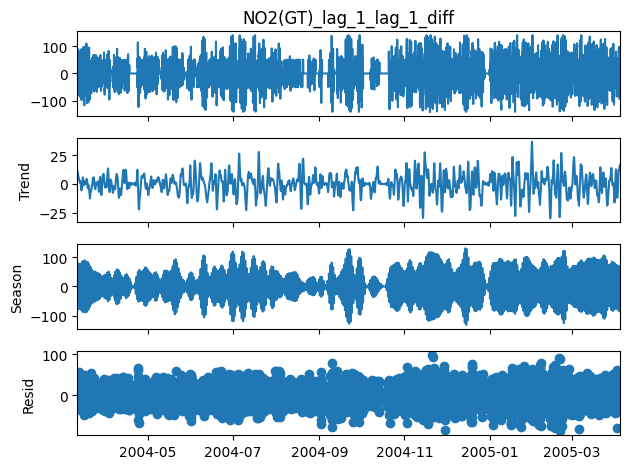

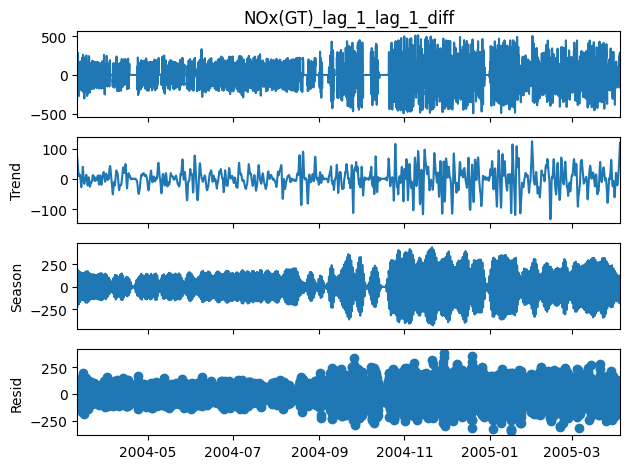

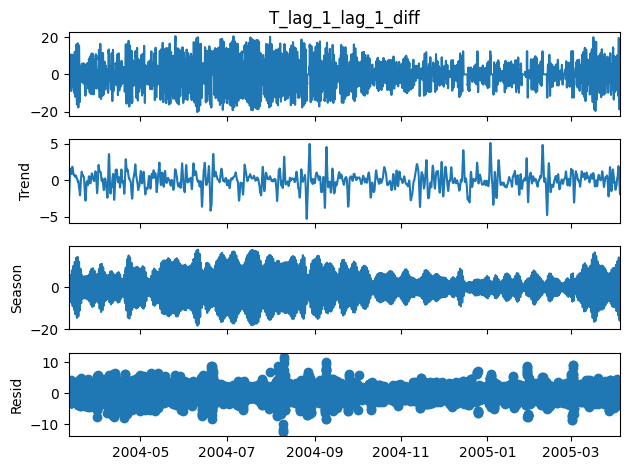

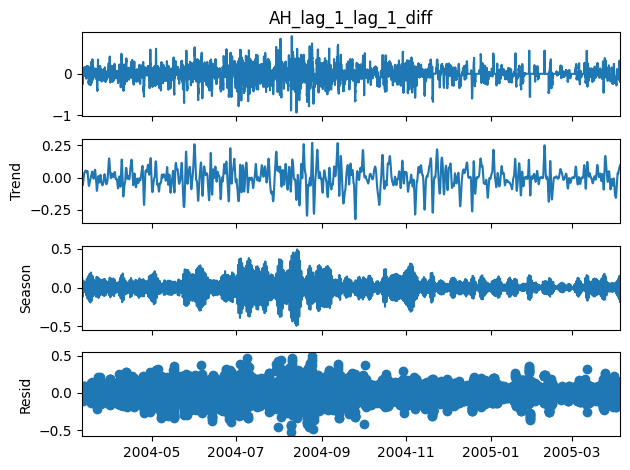

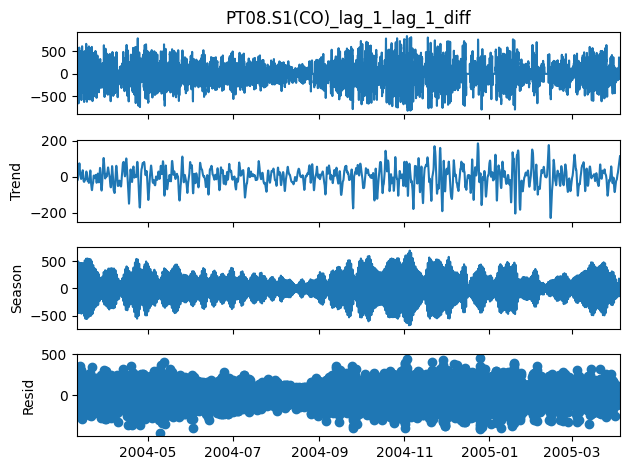

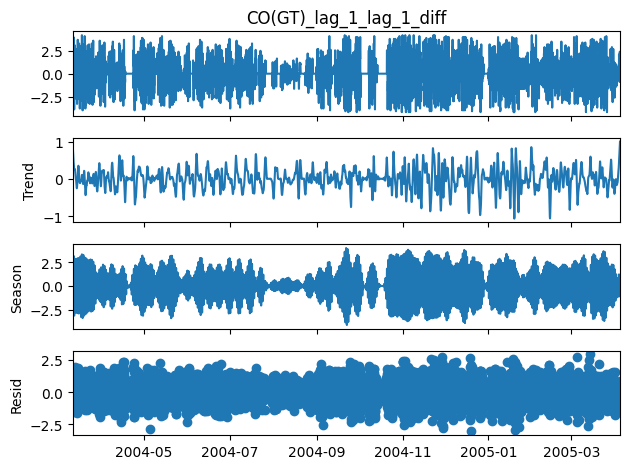

In [55]:
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.stattools import adfuller
import numpy as np

for column in ['NO2(GT)_lag_1_lag_1_diff', 'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff', 'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff']:
    print(f"Processing column: {column}")

    # Step 1: Decompose with STL
    stl = STL(co_df[column].dropna(), period=24)
    result = stl.fit()
    result.plot()

    # Step 2: Detrend and Deseasonalize
    detrended = co_df[column] - result.trend
    deseasonalized = detrended - result.seasonal
    co_df[f'{column}_final'] = deseasonalized

    # Step 3: Check Stationarity
    adf_result = adfuller(co_df[f'{column}_final'].dropna())
    if adf_result[1] > 0.05:
        print(f"{column}: Data is still not stationary. Further processing needed.")
    else:
        print(f"{column}: Data is stationary and ready for modeling.")


In [56]:
# co_df.dropna(axis=0,inplace=True)
# co_df = co_df.drop(['NO2(GT)_lag_1',	'NOx(GT)_lag_1'	,'T_lag_1',	'AH_lag_1',	'PT08.S1(CO)_lag_1',	'CO(GT)_lag_1','NO2(GT)_lag_1_lag_1_diff', 'NOx(GT)_lag_1_lag_1_diff', 'T_lag_1_lag_1_diff', 'AH_lag_1_lag_1_diff', 'PT08.S1(CO)_lag_1_lag_1_diff', 'CO(GT)_lag_1_lag_1_diff','NO2(GT)_lag_1_lag_1_diff_detrended', 'NOx(GT)_lag_1_lag_1_diff_detrended', 'T_lag_1_lag_1_diff_detrended', 'AH_lag_1_lag_1_diff_detrended', 'PT08.S1(CO)_lag_1_lag_1_diff_detrended', 'CO(GT)_lag_1_lag_1_diff_detrended'], axis=1)
# co_df.head()

In [57]:
# plt.figure(figsize=(15, 8))
# plt.plot(co_df.index, co_df['CO(GT)'], label='CO(GT)')
# plt.title('Time Series Plot')
# plt.xlabel('Date')
# plt.ylabel('CO(GT)')
# plt.legend()

# # print(co_df.index)
# # Set x-axis limits
# plt.xlim(co_df.index[0], co_df.index[300])

# plt.show()


####NO2 DATASET

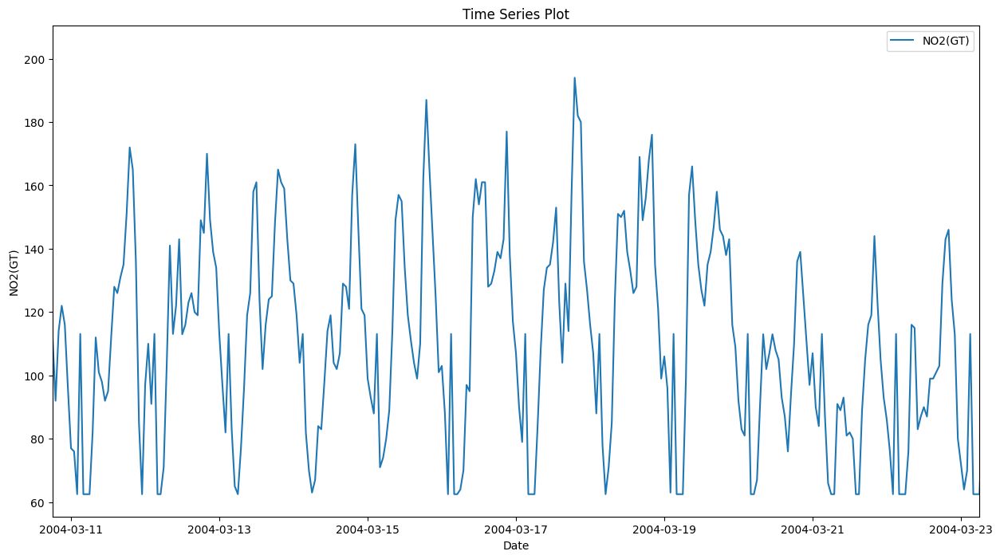

In [58]:
plt.figure(figsize=(15, 8))
plt.plot(no2_df.index, no2_df['NO2(GT)'], label='NO2(GT)')
plt.title('Time Series Plot')
plt.xlabel('Date')
plt.ylabel('NO2(GT)')
plt.legend()

# print(co_df.index)
# Set x-axis limits
plt.xlim(no2_df.index[0], no2_df.index[300])

plt.show()


In [59]:
for i in no2_df.columns:
  no2_df[f'{i}_lag_1'] = no2_df[i].shift(3)
  # co_df.loc[f'{i}_lag_2'] = co_df[i].shift(2)

<ipython-input-59-fa10a901e22e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no2_df[f'{i}_lag_1'] = no2_df[i].shift(3)
<ipython-input-59-fa10a901e22e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  no2_df[f'{i}_lag_1'] = no2_df[i].shift(3)
<ipython-input-59-fa10a901e22e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable

In [60]:
no2_df = no2_df.drop(no2_df.index[0:3])  # Drop the first row

In [61]:
no2_df = no2_df.resample('h').mean()
# Iterate over each column in the DataFrame to perform the ADF test
for column in ['NOx(GT)_lag_1',	'PT08.S4(NO2)_lag_1',	'T_lag_1',	'RH_lag_1']:
    result = adfuller(no2_df[column])  # Apply ADF test to individual column
    print(f"ADF Test for {column}:")
    print("ADF Statistic:", result[0])
    print("p-value:", result[1])

    if result[1] > 0.05:
        print("The series is not stationary. Differencing will be applied.")
        # Apply differencing to the individual column
        no2_df[f'{column}_log'] = no2_df[column].diff().dropna()
    else:
        print("The series is stationary. Proceeding without differencing.")

ADF Test for NOx(GT)_lag_1:
ADF Statistic: -7.1232739098673115
p-value: 3.6752490360666014e-10
The series is stationary. Proceeding without differencing.
ADF Test for PT08.S4(NO2)_lag_1:
ADF Statistic: -6.350740904059253
p-value: 2.6147417943382343e-08
The series is stationary. Proceeding without differencing.
ADF Test for T_lag_1:
ADF Statistic: -3.6689941856466293
p-value: 0.004571029943265394
The series is stationary. Proceeding without differencing.
ADF Test for RH_lag_1:
ADF Statistic: -7.424842488577792
p-value: 6.590069030914051e-11
The series is stationary. Proceeding without differencing.


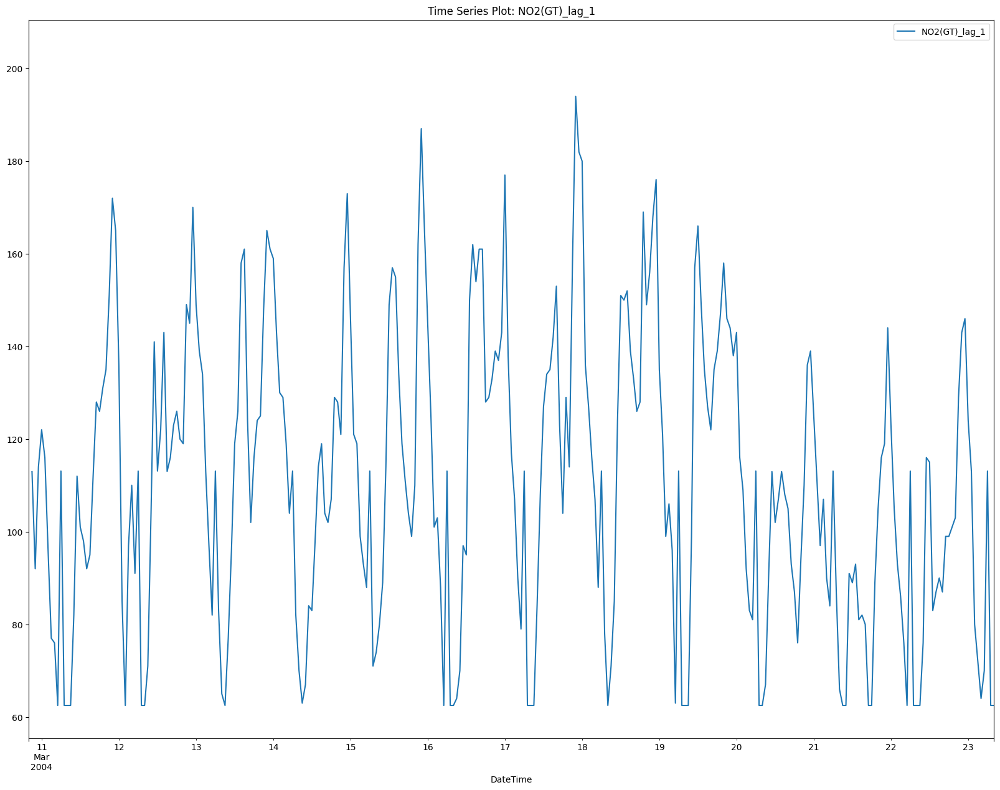

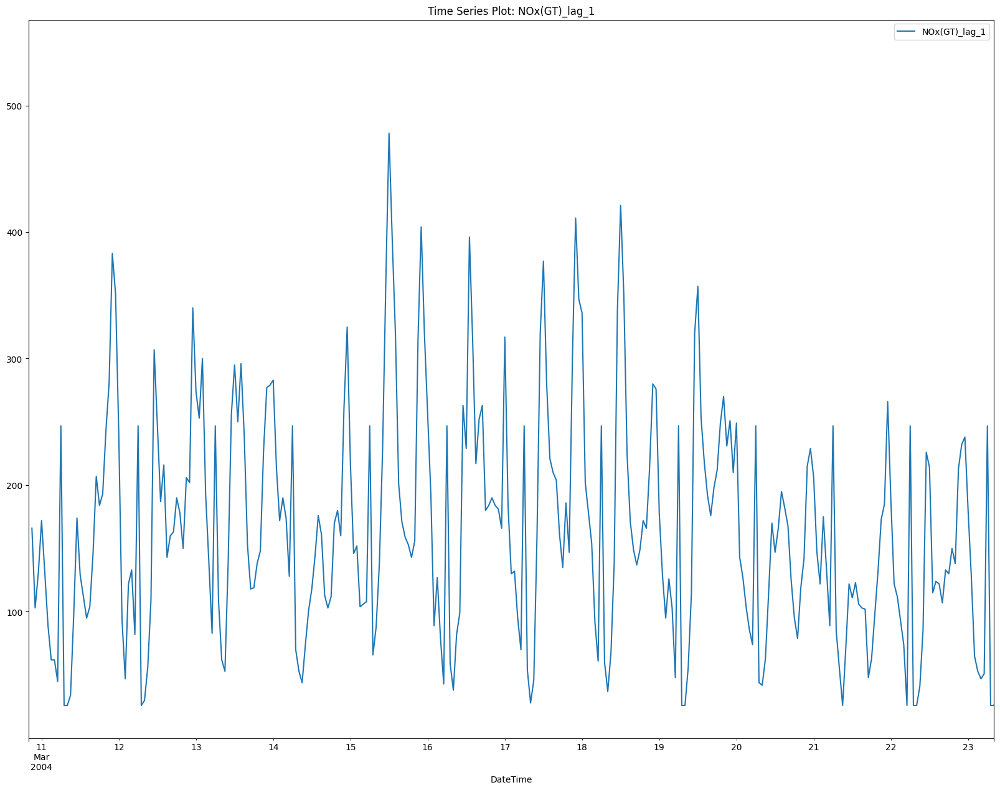

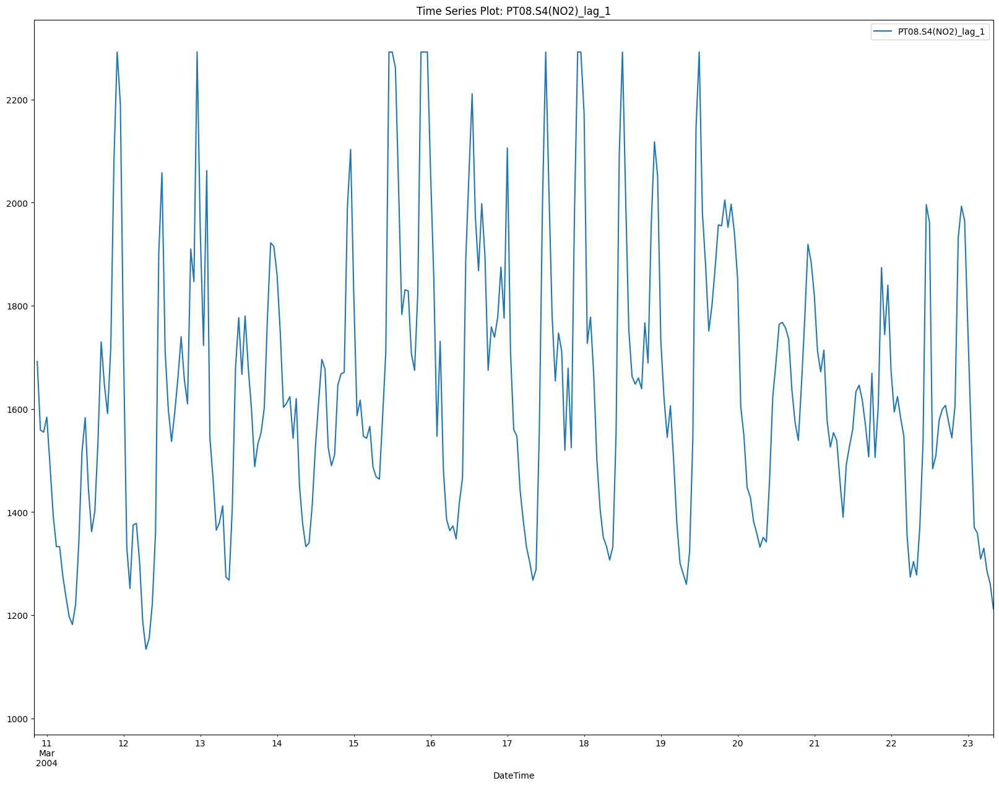

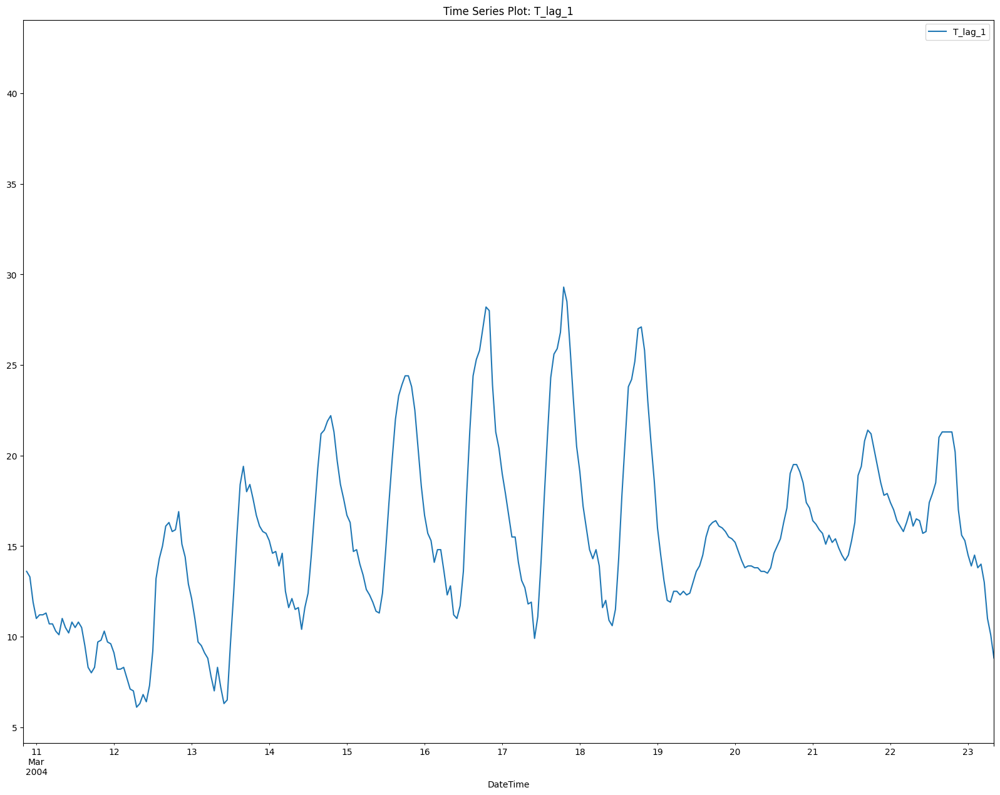

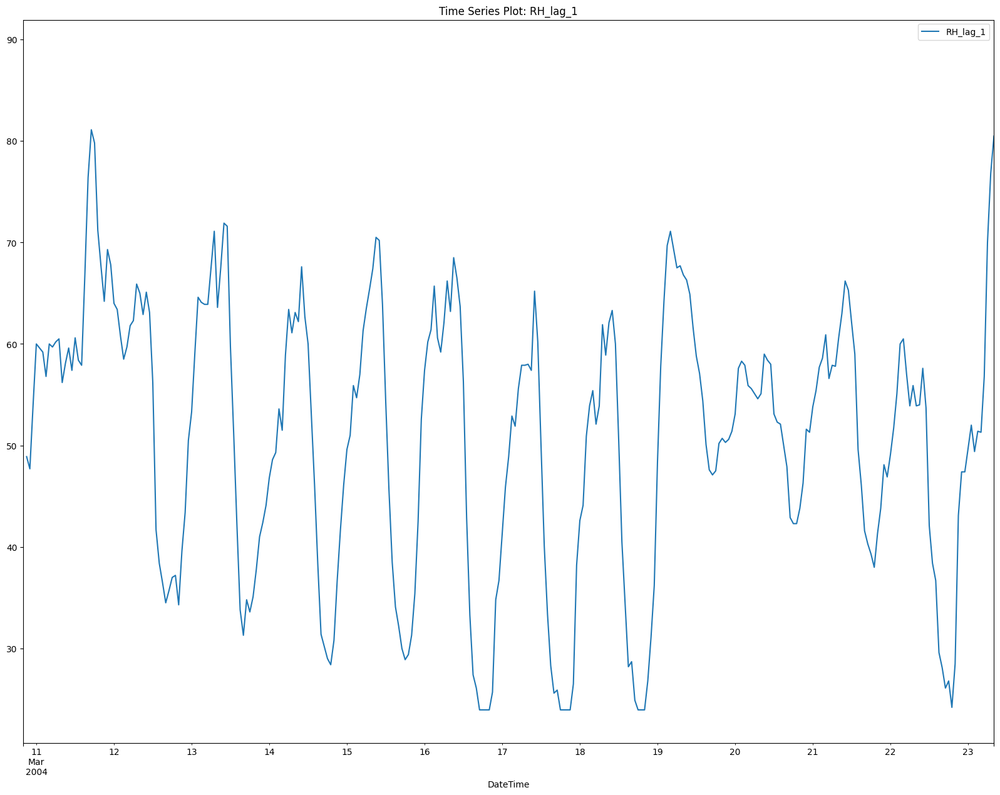

In [62]:
for column in ['NO2(GT)_lag_1','NOx(GT)_lag_1',	'PT08.S4(NO2)_lag_1',	'T_lag_1',	'RH_lag_1']:
    no2_df[column].plot(title=f"Time Series Plot: {column}", figsize=(20, 15), xlim=[co_df.index[0],co_df.index[300]])
    plt.legend()
    plt.show()


In [63]:
for column in ['NO2(GT)_lag_1','NOx(GT)_lag_1',	'PT08.S4(NO2)_lag_1',	'T_lag_1',	'RH_lag_1']:
  no2_df[f'{column}_lag_1_diff'] = no2_df[column].diff(periods=48)

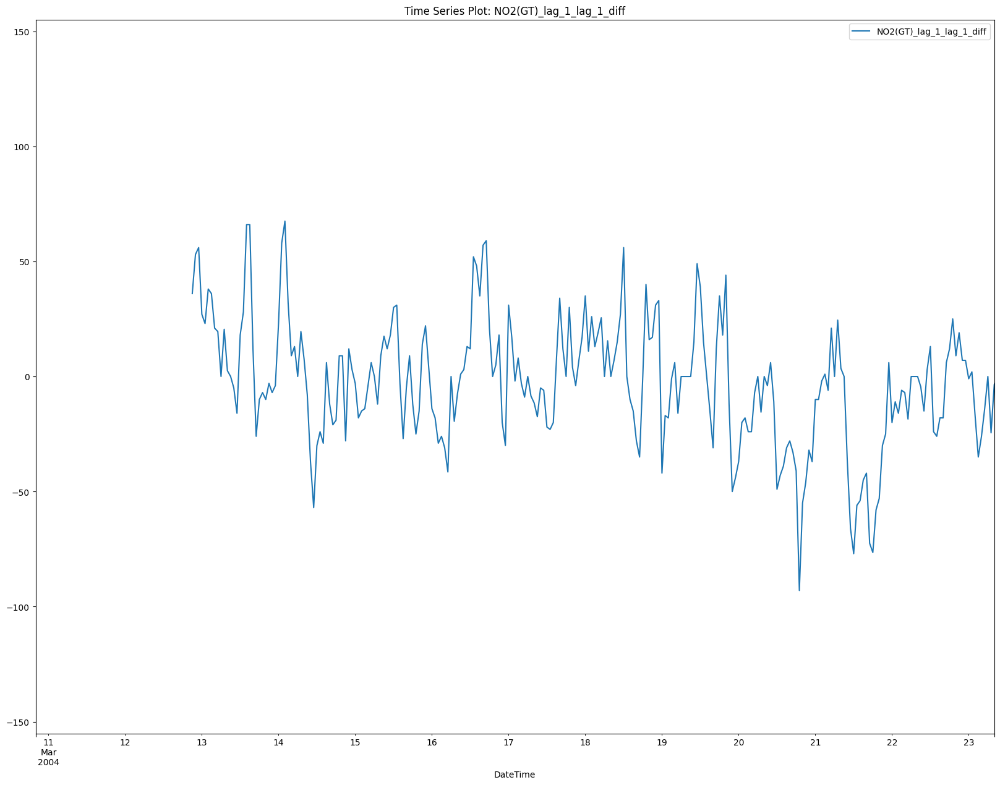

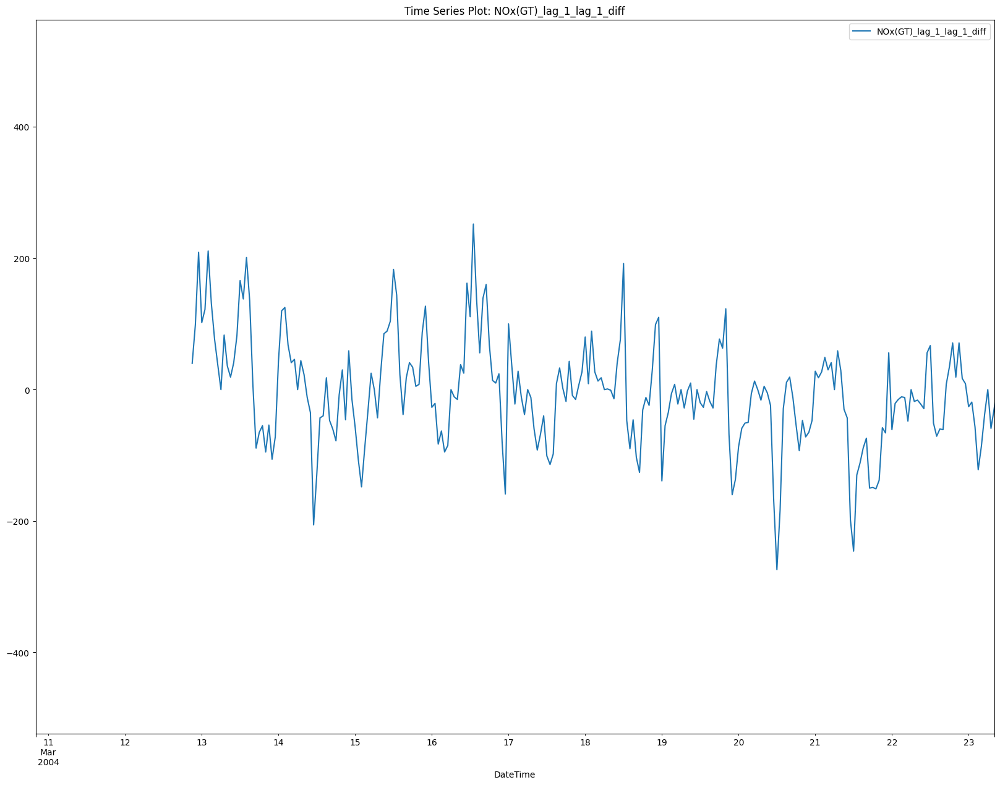

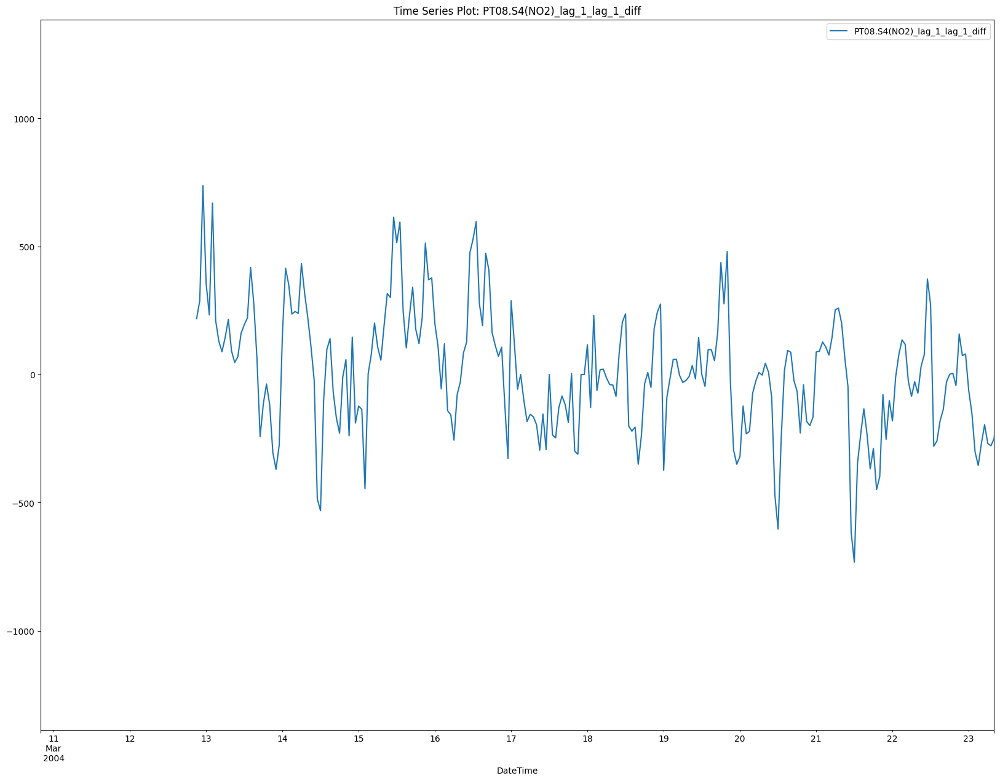

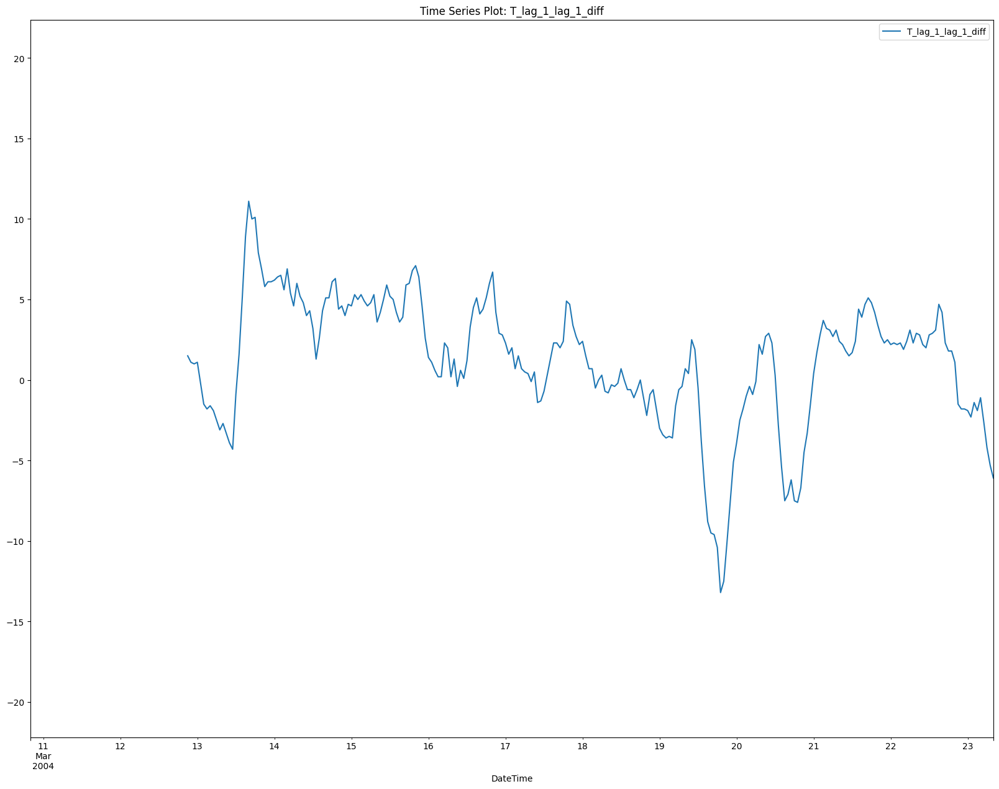

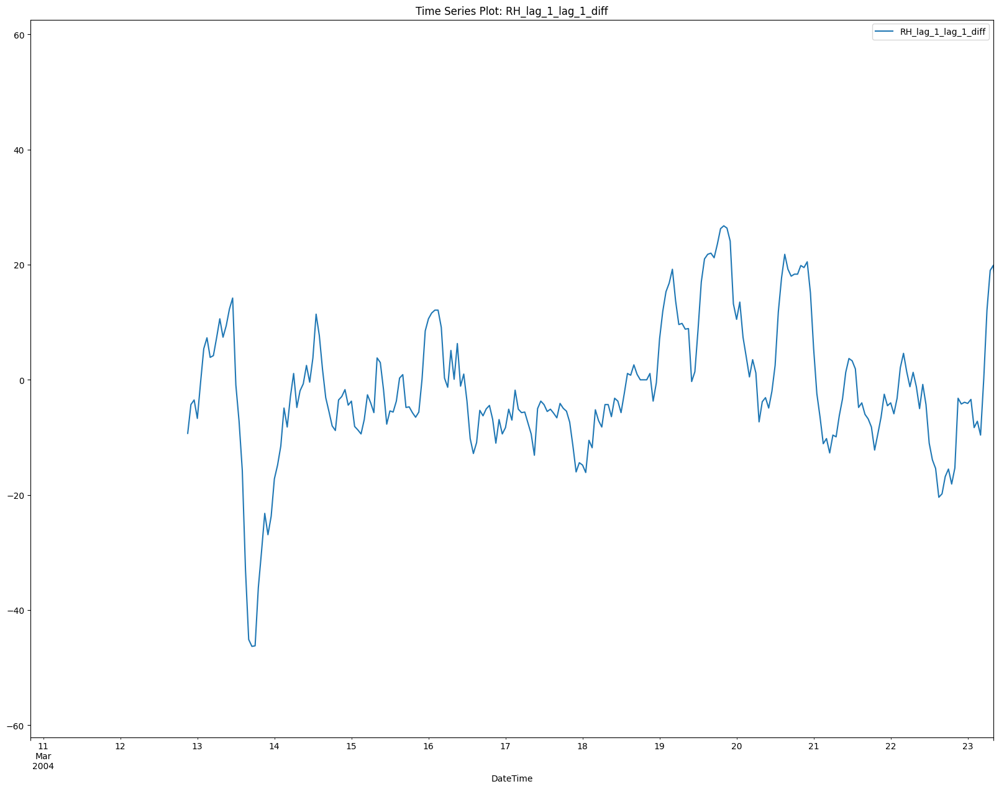

In [64]:
for column in ['NO2(GT)_lag_1_lag_1_diff','NOx(GT)_lag_1_lag_1_diff',	'PT08.S4(NO2)_lag_1_lag_1_diff',	'T_lag_1_lag_1_diff',	'RH_lag_1_lag_1_diff']:
    no2_df[column].plot(title=f"Time Series Plot: {column}", figsize=(20, 15), xlim=[co_df.index[0],co_df.index[300]])
    plt.legend()
    plt.show()


Processing column: NO2(GT)_lag_1_lag_1_diff
NO2(GT)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: NOx(GT)_lag_1_lag_1_diff
NOx(GT)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: PT08.S4(NO2)_lag_1_lag_1_diff
PT08.S4(NO2)_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: T_lag_1_lag_1_diff
T_lag_1_lag_1_diff: Data is stationary and ready for modeling.
Processing column: RH_lag_1_lag_1_diff
RH_lag_1_lag_1_diff: Data is stationary and ready for modeling.


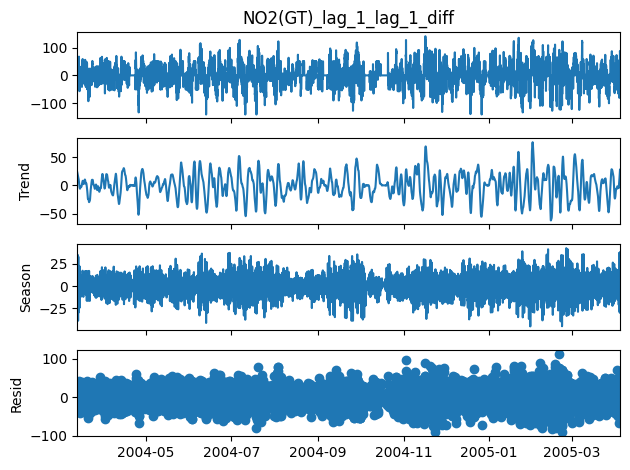

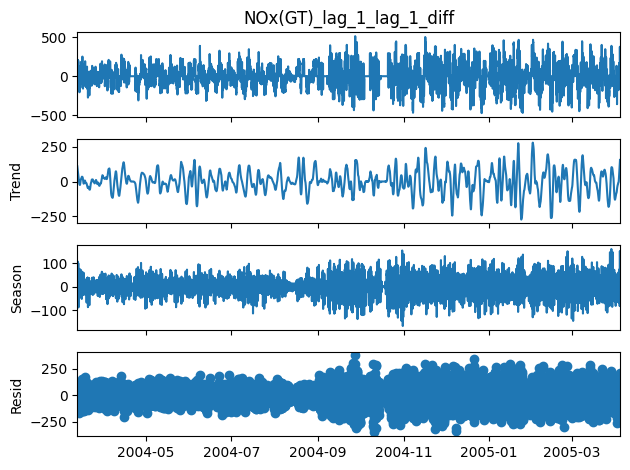

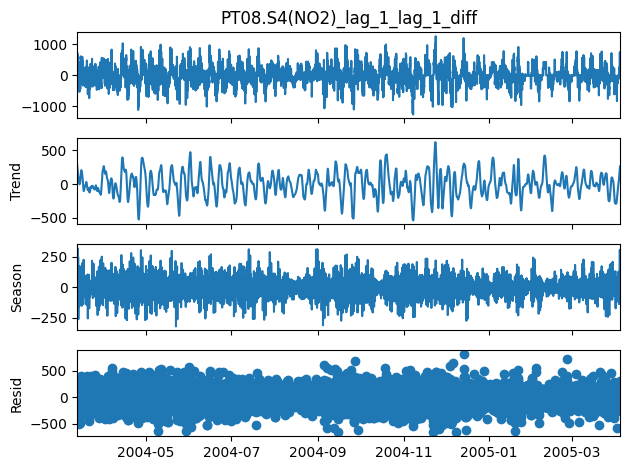

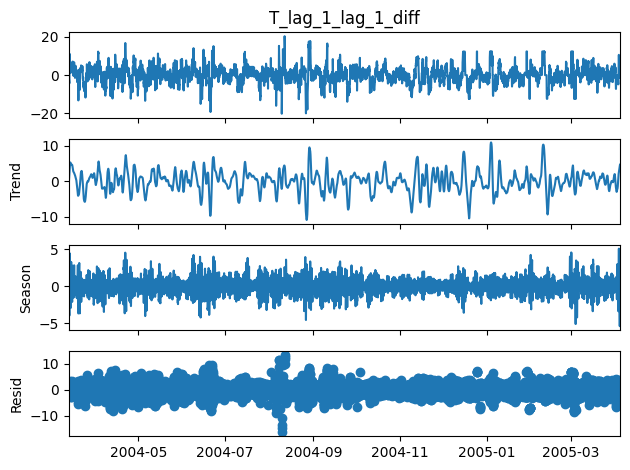

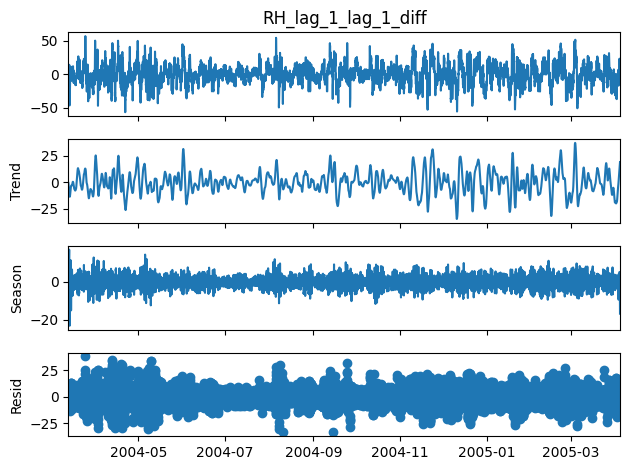

In [65]:
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.stattools import adfuller
import numpy as np

for column in ['NO2(GT)_lag_1_lag_1_diff','NOx(GT)_lag_1_lag_1_diff',	'PT08.S4(NO2)_lag_1_lag_1_diff',	'T_lag_1_lag_1_diff',	'RH_lag_1_lag_1_diff']:
    print(f"Processing column: {column}")

    # Step 1: Decompose with STL
    stl = STL(no2_df[column].dropna(), period=24)
    result = stl.fit()
    result.plot()

    # Step 2: Detrend and Deseasonalize
    detrended = no2_df[column] - result.trend
    deseasonalized = detrended - result.seasonal
    no2_df[f'{column}_final'] = deseasonalized

    # Step 3: Check Stationarity
    adf_result = adfuller(no2_df[f'{column}_final'].dropna())
    if adf_result[1] > 0.05:
        print(f"{column}: Data is still not stationary. Further processing needed.")
    else:
        print(f"{column}: Data is stationary and ready for modeling.")


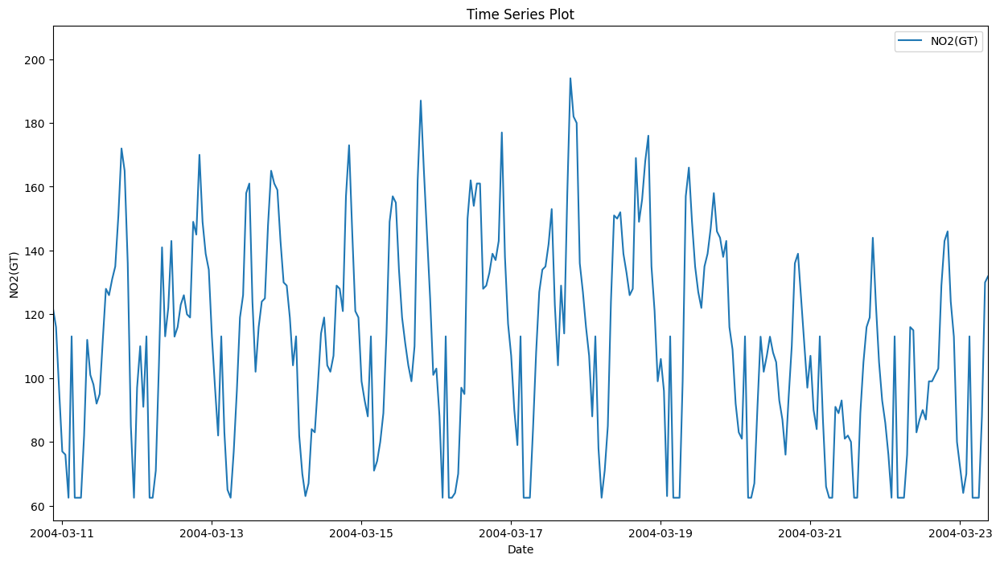

In [66]:
plt.figure(figsize=(15, 8))
plt.plot(no2_df.index, no2_df['NO2(GT)'], label='NO2(GT)')
plt.title('Time Series Plot')
plt.xlabel('Date')
plt.ylabel('NO2(GT)')
plt.legend()

# print(co_df.index)
# Set x-axis limits
plt.xlim(no2_df.index[0], no2_df.index[300])

plt.show()


### 4. Time-Series Forecasting
- Train separate models for **CO(GT)** and **NO₂(GT)**.
- Explore the following forecasting approaches:
  - **Statistical Models**:
    - Classical models like ARIMA or SARIMA for univariate forecasting.
  - **Machine Learning Models**:
    - Use regression models trained on lag features and external predictors.
  - **Deep Learning Models**:
    - Apply LSTM, GRU, or other RNN-based models for sequence forecasting.
- Evaluate and compare the models.


####CO SARIMAX

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                      SARIMAX Results                                       
Dep. Variable:                               CO(GT)   No. Observations:                 9355
Model:             SARIMAX(2, 1, 2)x(1, 1, [1], 24)   Log Likelihood               -4180.399
Date:                              Mon, 06 Jan 2025   AIC                           8384.799
Time:                                      12:24:31   BIC                           8470.491
Sample:                                  03-10-2004   HQIC                          8413.905
                                       - 04-04-2005                                         
Covariance Type:                                opg                                         
                  coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------
NO2(GT)         0.0020      0.000      6.131      0.000       0.001       0.003
NOx(GT)         

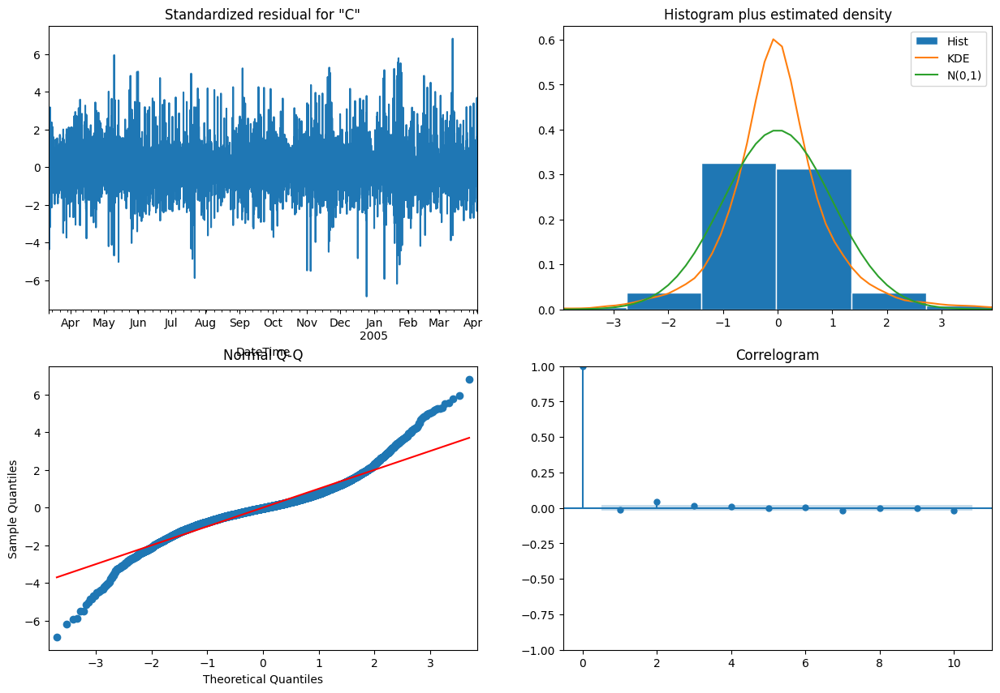

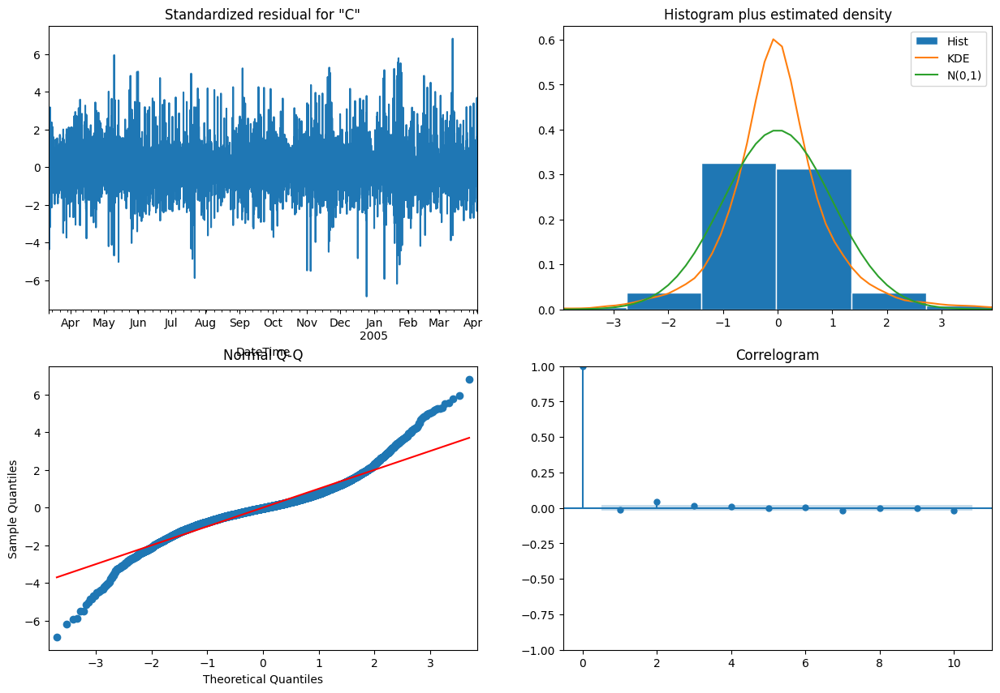

In [67]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Updated model with refined ARIMA and seasonal orders
model = SARIMAX(co_df['CO(GT)'], exog=co_df[['NO2(GT)','NOx(GT)','T','AH','PT08.S1(CO)']], order=(2, 1, 2), seasonal_order=(1, 1, 1, 24))
results = model.fit()

# Summary and diagnostics
print(results.summary())
results.plot_diagnostics(figsize=(15, 10))

####NO2 SARIMAX

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                      
Dep. Variable:                            NO2(GT)   No. Observations:                 9354
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 24)   Log Likelihood              -34817.662
Date:                            Mon, 06 Jan 2025   AIC                          69653.325
Time:                                    12:28:52   BIC                          69717.593
Sample:                                03-10-2004   HQIC                         69675.154
                                     - 04-04-2005                                         
Covariance Type:                              opg                                         
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
NOx(GT)          0.1951      0.001    143.245      0.000       0.192       0.198
PT08.S4(NO2)     0.0100      

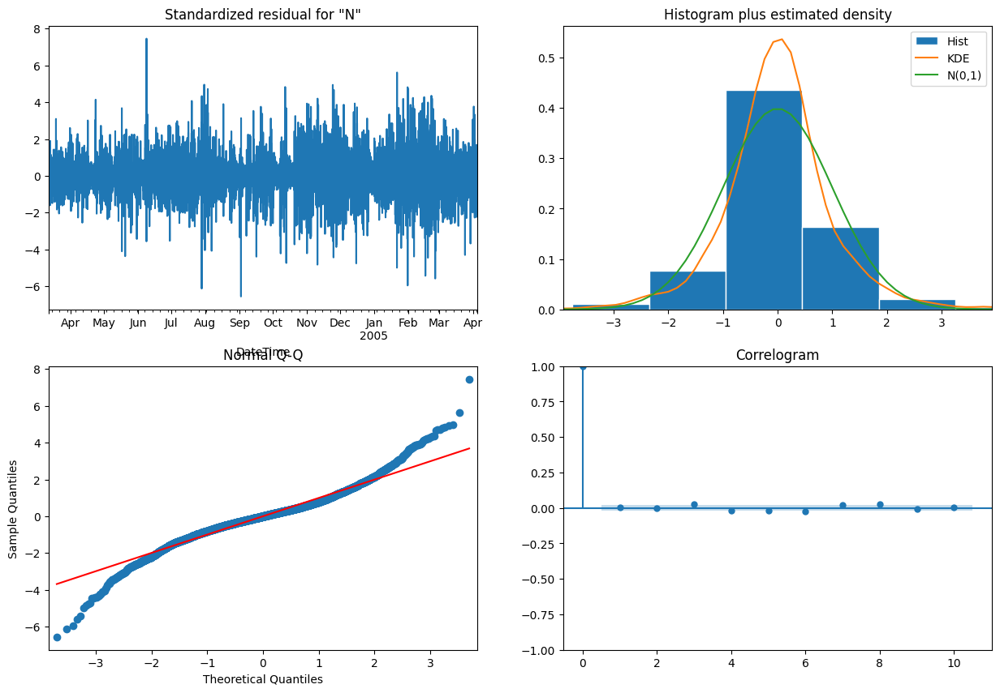

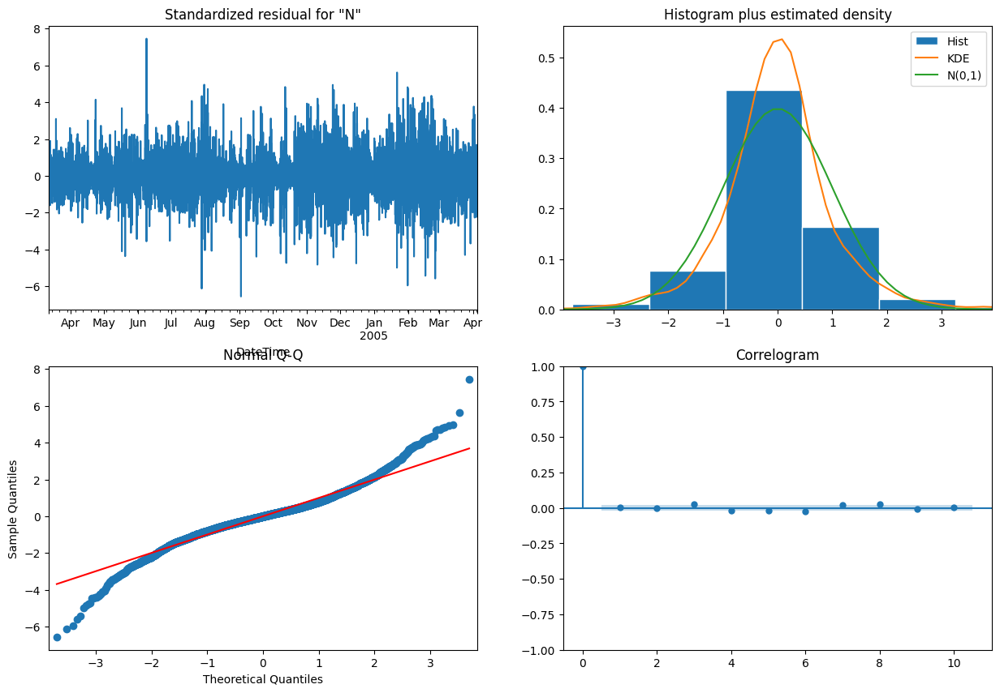

In [68]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

model2 = SARIMAX(no2_df['NO2(GT)'], exog=no2_df[['NOx(GT)',	'PT08.S4(NO2)',	'T',	'RH']], order=(1, 1, 1), seasonal_order=(1, 1, 1, 24))
results2 = model2.fit()

# Summary and diagnostics
print(results2.summary())
results2.plot_diagnostics(figsize=(15, 10))

In [69]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression

x = co_df.drop('CO(GT)', axis=1)
y = co_df['CO(GT)']

In [70]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x[['NO2(GT)','NOx(GT)','T','AH','PT08.S1(CO)']], y, test_size=0.2, random_state=42)
log = LinearRegression()
log.fit(x_train, y_train)
log.score(x_test, y_test)

0.7231645866404177

##### LSTM

In [94]:
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error


features = ['PT08.S1(CO)','NOx(GT)', 'NO2(GT)', 'T', 'AH']
target = 'CO(GT)'  # or 'NO2(GT)'

# Scale the data
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(co_df[features])

# Create sequences
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data)-seq_length):
        X.append(data[i:i+seq_length, :-1])
        y.append(data[i+seq_length, -1])
    return np.array(X), np.array(y)

seq_length = 24  # Example sequence length
X, y = create_sequences(scaled_data, seq_length)

# Split into training and testing sets
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

model3 = Sequential()
model3.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model3.add(LSTM(units=50))
model3.add(Dense(1))

model3.compile(optimizer='adam', loss='mean_squared_error')
model3.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 24, 50)            11000     
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 31251 (122.07 KB)
Trainable params: 31251 (122.07 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [96]:
history = model3.fit(X_train, y_train, epochs=20, batch_size=32, validation_split=0.2)

Epoch 1/20
187/187 [==============================] - 8s 25ms/step - loss: 0.0271 - val_loss: 0.0153
Epoch 2/20
187/187 [==============================] - 4s 21ms/step - loss: 0.0177 - val_loss: 0.0282
Epoch 3/20
187/187 [==============================] - 4s 20ms/step - loss: 0.0176 - val_loss: 0.0325
Epoch 4/20
187/187 [==============================] - 3s 18ms/step - loss: 0.0168 - val_loss: 0.0171
Epoch 5/20
187/187 [==============================] - 4s 19ms/step - loss: 0.0167 - val_loss: 0.0372
Epoch 6/20
187/187 [==============================] - 4s 19ms/step - loss: 0.0162 - val_loss: 0.0160
Epoch 7/20
187/187 [==============================] - 4s 20ms/step - loss: 0.0166 - val_loss: 0.0276
Epoch 8/20
187/187 [==============================] - 4s 21ms/step - loss: 0.0161 - val_loss: 0.0241
Epoch 9/20
187/187 [==============================] - 4s 20ms/step - loss: 0.0160 - val_loss: 0.0231
Epoch 10/20
187/187 [==============================] - 4s 22ms/step - loss: 0.0156 - val_lo

59/59 [==============================] - 1s 9ms/step
RMSE: 0.330203661711536


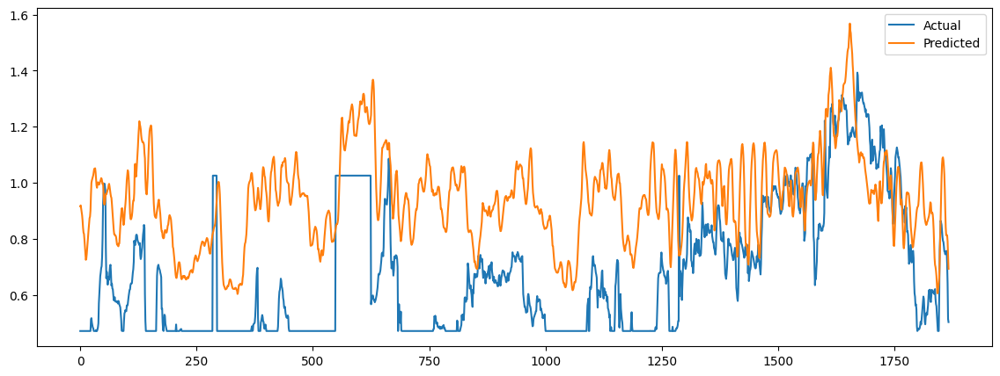

In [98]:
# Make predictions
y_pred = model3.predict(X_test)

# Inverse transform the predictions and actual values
y_pred = scaler.inverse_transform(np.concatenate((np.zeros((y_pred.shape[0], X_test.shape[2])), y_pred), axis=1))[:, -1]
y_test = scaler.inverse_transform(np.concatenate((np.zeros((y_test.shape[0], X_test.shape[2])), y_test.reshape(-1, 1)), axis=1))[:, -1]

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse}')

# Plot the results
plt.figure(figsize=(14, 5))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.legend()
plt.show()


### 5. Model Evaluation
- Use appropriate metrics for forecasting:
  - Mean Absolute Error (MAE)
  - Root Mean Squared Error (RMSE)
  - Mean Absolute Percentage Error (MAPE)
- Plot actual vs. predicted values to visualize performance.


####NO2 Dataset Randomforest Tree

In [85]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

x_train_no2, x_test_no2, y_train_no2, y_test_no2 = train_test_split(no2_df[['NOx(GT)','T','RH','PT08.S4(NO2)']], no2_df['NO2(GT)'], test_size=0.2, random_state=42)
rf2 = RandomForestRegressor(random_state=42)

param_grid = {
    'n_estimators': [100, 200, 500],
    'max_depth': [10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None],
    'bootstrap': [True, False]
}

grid_search_rf2 = GridSearchCV(rf2, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid_search_rf2.fit(x_train_no2, y_train_no2)

print("Best Parameters for Random Forest: ", grid_search_rf2.best_params_)
print("Best Score (Negative MSE) for Random Forest: ", grid_search_rf2.best_score_)


Best Parameters for Random Forest:  {'bootstrap': True, 'max_depth': 15, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}
Best Score (Negative MSE) for Random Forest:  -229.07774272335033


In [88]:
rf2 = RandomForestRegressor(bootstrap= True, max_depth= 15, max_features= 'sqrt', min_samples_leaf= 1, min_samples_split= 10, n_estimators= 200)
rf2.fit(x_train_no2, y_train_no2)
rf2.score(x_test_no2, y_test_no2)

0.8434447260076137

### CO Dataset Randomforest Tree

In [89]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

x_train, x_test, y_train, y_test = train_test_split(x[['NO2(GT)','NOx(GT)','T','AH','PT08.S1(CO)']], y, test_size=0.2, random_state=42)
rf = RandomForestRegressor()

# param_grid = {
#     'n_estimators': [50, 100],
#     'max_depth': [None, 10,30],
#     'min_samples_split': [2, 5],
#     'min_samples_leaf': [1, 2]
# }

param_grid = {
    'n_estimators': [100, 200, 500],
    'max_depth': [10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None],
    'bootstrap': [True, False]
}

grid_search_rf = GridSearchCV(rf, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid_search_rf.fit(x_train, y_train)

print("Best Parameters for Random Forest: ", grid_search_rf.best_params_)
print("Best Score (Negative MSE) for Random Forest: ", grid_search_rf.best_score_)


Best Parameters for Random Forest:  {'bootstrap': True, 'max_depth': 15, 'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 500}
Best Score (Negative MSE) for Random Forest:  -0.2508264540427787


In [90]:
rf = RandomForestRegressor(bootstrap= True, max_depth= 15, max_features= "log2", min_samples_leaf= 2, min_samples_split= 2, n_estimators= 500)
rf.fit(x_train, y_train)
rf.score(x_test, y_test)

0.8047231873457603

### CO PREDICTION MODEL EVALUATION

Mean Absolute Error (MAE): 0.26006680048566594
Root Mean Squared Error (RMSE): 0.38100718808529266
Mean Absolute Percentage Error (MAPE): 17.126649782783215%


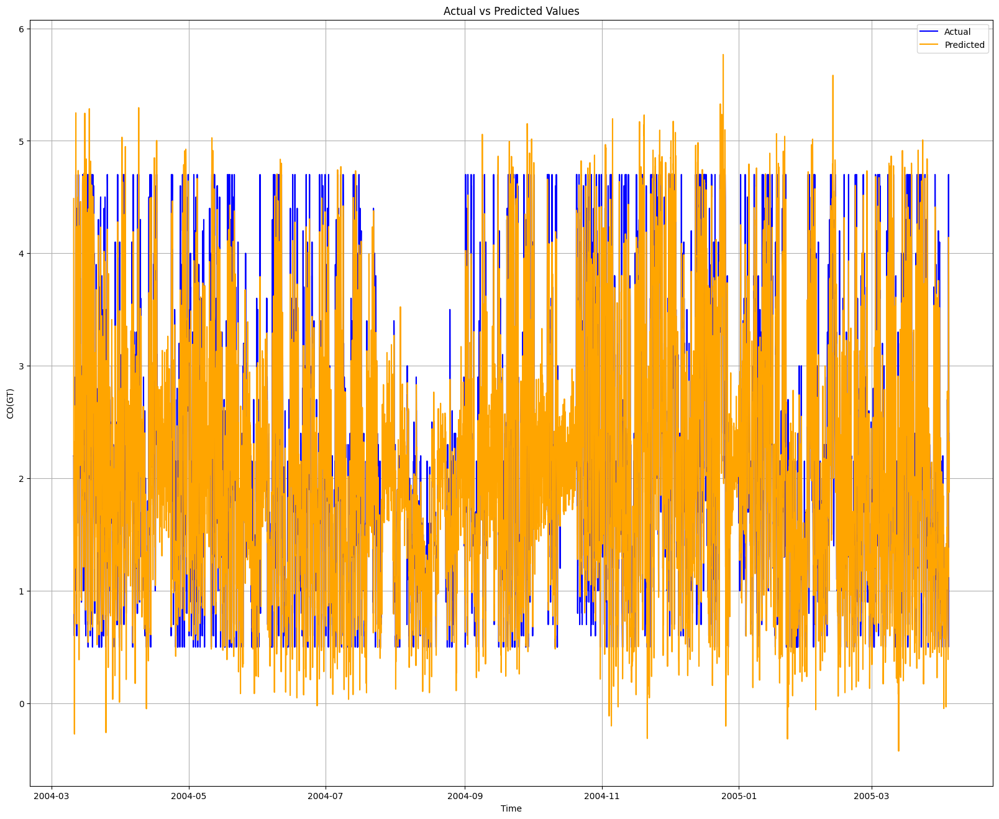

In [73]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Example: Replace 'y_actual' and 'y_predicted' with your actual and predicted series.
y_actual = co_df['CO(GT)']  # Replace with actual test data
y_predicted = results.predict( start=co_df.index[0], end=co_df.index[-1])

# Calculate Metrics
mae = mean_absolute_error(y_actual, y_predicted)
rmse = np.sqrt(mean_squared_error(y_actual, y_predicted))
mape = np.mean(np.abs((y_actual - y_predicted) / y_actual)) * 100

# Print Metrics
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Percentage Error (MAPE): {mape}%")

# Plot Actual vs Predicted
plt.figure(figsize=(20, 16))
plt.plot(y_actual, label='Actual', color='blue')
plt.plot(y_predicted, label='Predicted', color='orange')
plt.title('Actual vs Predicted Values')
plt.xlabel('Time')
plt.ylabel('CO(GT)')
plt.legend()
plt.grid()
plt.show()


### NO2 PREDICTION MODEL EVALUATION

Mean Absolute Error (MAE): 7.200891966415834
Root Mean Squared Error (RMSE): 10.14242135991777
Mean Absolute Percentage Error (MAPE): 6.707826489165152%


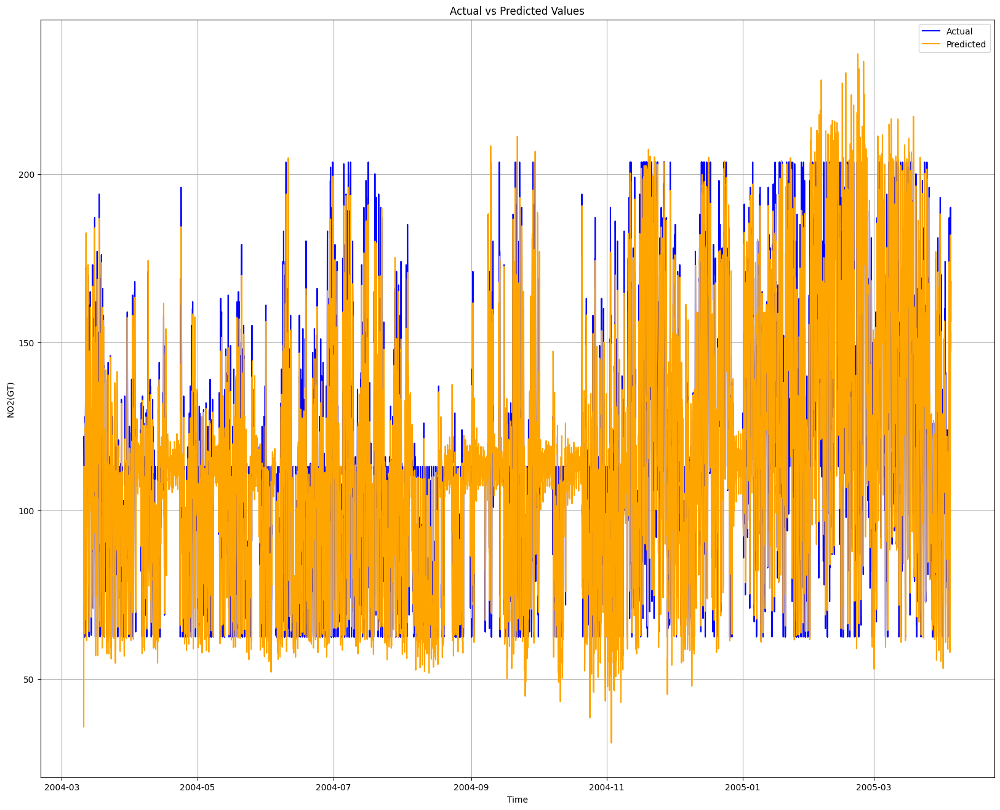

In [74]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Example: Replace 'y_actual' and 'y_predicted' with your actual and predicted series.
y_actual_no2 = no2_df['NO2(GT)']  # Replace with actual test data
y_predicted_no2 = results2.predict( start=no2_df.index[0], end=no2_df.index[-1])

# Calculate Metrics
mae = mean_absolute_error(y_actual_no2, y_predicted_no2)
rmse = np.sqrt(mean_squared_error(y_actual_no2, y_predicted_no2))
mape = np.mean(np.abs((y_actual_no2 - y_predicted_no2) / y_actual_no2)) * 100

# Print Metrics
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Percentage Error (MAPE): {mape}%")

# Plot Actual vs Predicted
plt.figure(figsize=(20, 16))
plt.plot(y_actual_no2, label='Actual', color='blue')
plt.plot(y_predicted_no2, label='Predicted', color='orange')
plt.title('Actual vs Predicted Values')
plt.xlabel('Time')
plt.ylabel('NO2(GT)')
plt.legend()
plt.grid()
plt.show()


### 6. Visualization and Insights
- Generate forecasts for future dates and visualize the trends.
- Highlight seasonal patterns, peak times, and periods of concern.
- Provide actionable recommendations based on predicted trends.



#### CO Dataset

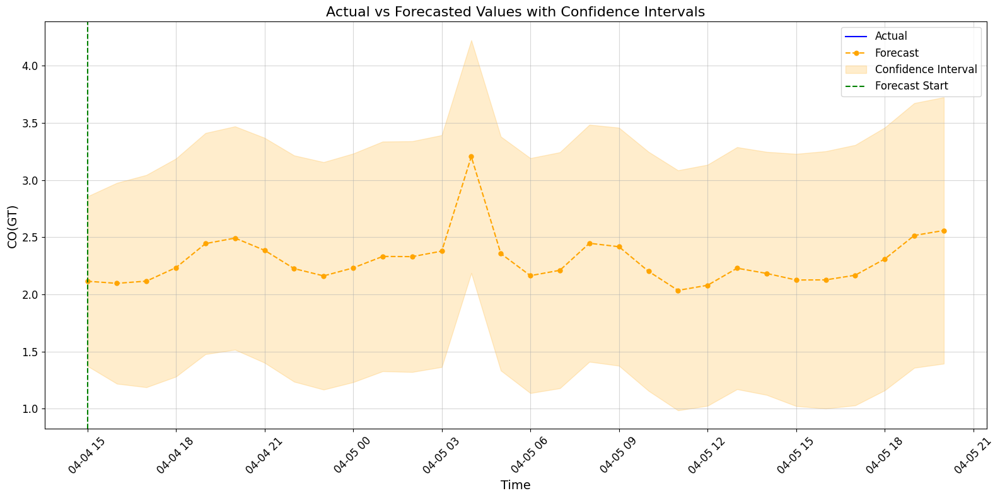

In [75]:
future_steps = 30
last_exog = co_df[['NO2(GT)','NOx(GT)','T','AH','PT08.S1(CO)']].iloc[-1].values.reshape(1, -1)

# Create future exogenous values (e.g., using the last known values or another method)
future_exog = pd.DataFrame(np.repeat(last_exog, future_steps, axis=0),
                          index=pd.date_range(start=co_df.index[-1], periods=future_steps + 1, freq='h')[1:],
                          columns=['NO2(GT)','NOx(GT)','T','AH','PT08.S1(CO)'])
forecast = results.get_forecast(steps=future_steps, exog=future_exog)
forecast_index = pd.date_range(start=co_df.index[-1], periods=future_steps + 1, freq='h')[1:]
forecast_values = forecast.predicted_mean
forecast_ci = forecast.conf_int()

# Assign forecast index
forecast_values.index = forecast_index
forecast_ci.index = forecast_index

# Enhanced Plot for Better Visibility
plt.figure(figsize=(16, 8))

# Plot actual values
plt.plot(y_actual[-1:0], label='Actual', color='blue', linewidth=1.5)

# Plot forecasted values
plt.plot(forecast_values, label='Forecast', color='orange', marker='o', markersize=5, linestyle='--')

# Plot confidence intervals
plt.fill_between(forecast_ci.index,
                 forecast_ci.iloc[:, 0],
                 forecast_ci.iloc[:, 1], color='orange', alpha=0.2, label='Confidence Interval')

# Add a vertical line to indicate where the forecast starts
plt.axvline(x=forecast_index[0], color='green', linestyle='--', label='Forecast Start')

# Customize title and labels
plt.title('Actual vs Forecasted Values with Confidence Intervals', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('CO(GT)', fontsize=14)

# Improve ticks and grid
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(alpha=0.5)

# Add legend
plt.legend(fontsize=12)

# Tight layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()



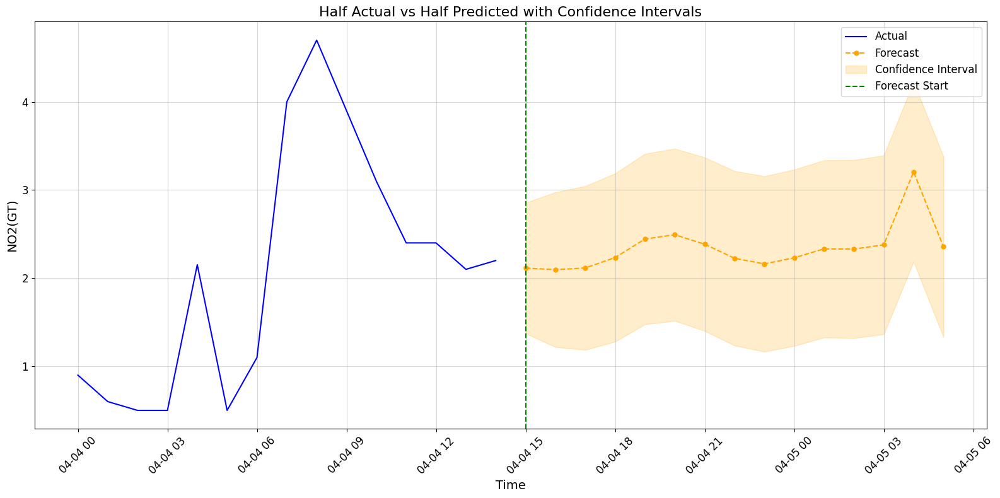

In [76]:
# Define the length of the data to display
total_points = 30  # Adjust this number based on the size of your dataset
actual_points = total_points // 2  # First half for actual, second half for predicted

# Get the last portion of actual data and forecast data
recent_actual = y_actual[-actual_points:]
forecast_values_limited = forecast_values[:total_points - actual_points]
forecast_ci_limited = forecast_ci.iloc[:total_points - actual_points]

# Combine actual and predicted for plotting
combined_index = list(recent_actual.index) + list(forecast_values_limited.index)
combined_values = pd.concat([recent_actual, forecast_values_limited])

# Enhanced Plot for Half Actual and Half Predicted
plt.figure(figsize=(16, 8))

# Plot actual values
plt.plot(recent_actual, label='Actual', color='blue', linewidth=1.5)

# Plot forecasted values
plt.plot(forecast_values_limited, label='Forecast', color='orange', marker='o', markersize=5, linestyle='--')

# Plot confidence intervals for the forecasted data
plt.fill_between(forecast_ci_limited.index,
                 forecast_ci_limited.iloc[:, 0],
                 forecast_ci_limited.iloc[:, 1], color='orange', alpha=0.2, label='Confidence Interval')

# Add a vertical line to separate actual and forecasted regions
plt.axvline(x=forecast_values_limited.index[0], color='green', linestyle='--', label='Forecast Start')

# Customize title and labels
plt.title('Half Actual vs Half Predicted with Confidence Intervals', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('CO(GT)', fontsize=14)

# Improve ticks and grid
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(alpha=0.5)

# Add legend
plt.legend(fontsize=12)

# Tight layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


#### NO2 Dataset

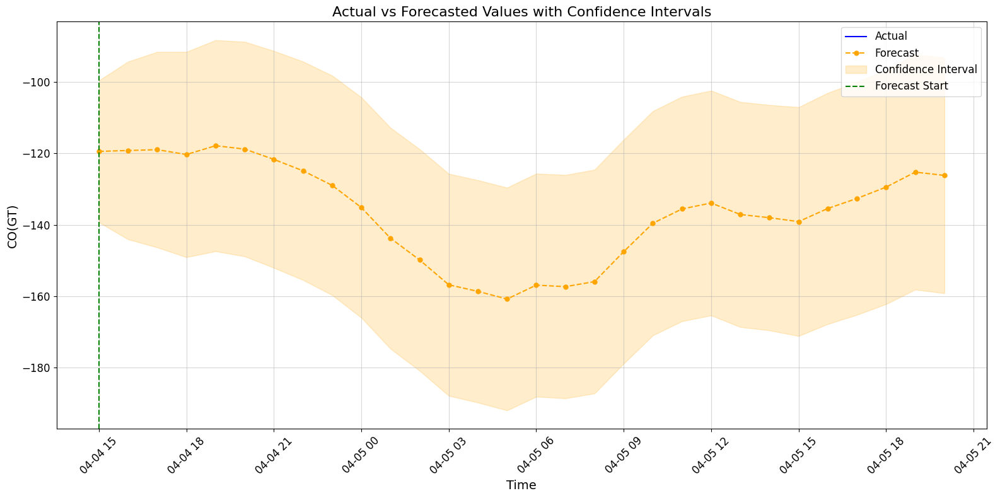

In [80]:
future_steps = 30
last_exog = no2_df[['NOx(GT)','T','RH','PT08.S4(NO2)']].iloc[-1].values.reshape(1, -1)

# Create future exogenous values (e.g., using the last known values or another method)
future_exog = pd.DataFrame(np.repeat(last_exog, future_steps, axis=0),
                          index=pd.date_range(start=no2_df.index[-1], periods=future_steps + 1, freq='h')[1:],
                          columns=['NOx(GT)','T','RH','PT084.(NO2)'])
forecast = results2.get_forecast(steps=future_steps, exog=future_exog)
forecast_index = pd.date_range(start=no2_df.index[-1], periods=future_steps + 1, freq='h')[1:]
forecast_values = forecast.predicted_mean
forecast_ci = forecast.conf_int()

# Assign forecast index
forecast_values.index = forecast_index
forecast_ci.index = forecast_index

# Enhanced Plot for Better Visibility
plt.figure(figsize=(16, 8))

# Plot actual values
plt.plot(y_actual[-1:0], label='Actual', color='blue', linewidth=1.5)

# Plot forecasted values
plt.plot(forecast_values, label='Forecast', color='orange', marker='o', markersize=5, linestyle='--')

# Plot confidence intervals
plt.fill_between(forecast_ci.index,
                 forecast_ci.iloc[:, 0],
                 forecast_ci.iloc[:, 1], color='orange', alpha=0.2, label='Confidence Interval')

# Add a vertical line to indicate where the forecast starts
plt.axvline(x=forecast_index[0], color='green', linestyle='--', label='Forecast Start')

# Customize title and labels
plt.title('Actual vs Forecasted Values with Confidence Intervals', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('CO(GT)', fontsize=14)

# Improve ticks and grid
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(alpha=0.5)

# Add legend
plt.legend(fontsize=12)

# Tight layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()



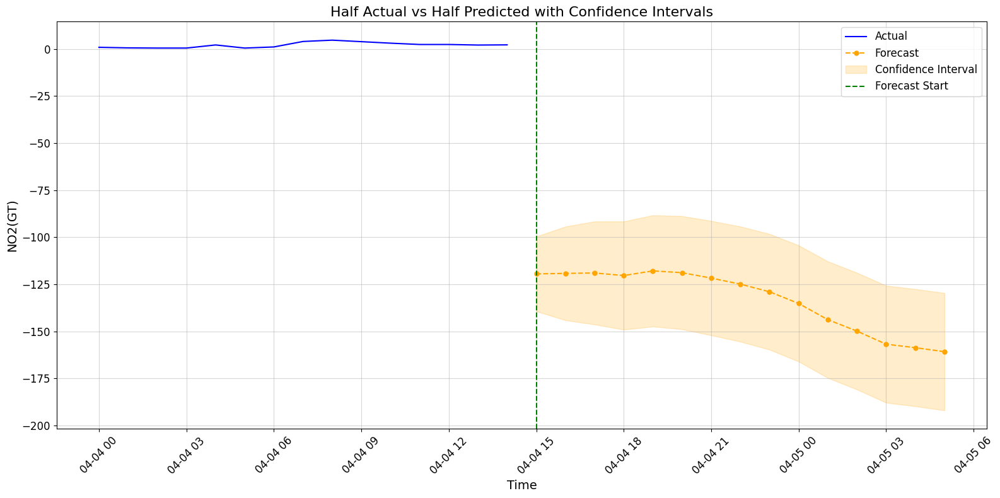

In [81]:
total_points = 30
actual_points = total_points // 2

# Get the last portion of actual data and forecast data
recent_actual = y_actual[-actual_points:]
forecast_values_limited = forecast_values[:total_points - actual_points]
forecast_ci_limited = forecast_ci.iloc[:total_points - actual_points]

# Combine actual and predicted for plotting
combined_index = list(recent_actual.index) + list(forecast_values_limited.index)
combined_values = pd.concat([recent_actual, forecast_values_limited])


plt.figure(figsize=(16, 8))

# Plot actual values
plt.plot(recent_actual, label='Actual', color='blue', linewidth=1.5)

# Plot forecasted values
plt.plot(forecast_values_limited, label='Forecast', color='orange', marker='o', markersize=5, linestyle='--')

# Plot confidence intervals for the forecasted data
plt.fill_between(forecast_ci_limited.index,
                 forecast_ci_limited.iloc[:, 0],
                 forecast_ci_limited.iloc[:, 1], color='orange', alpha=0.2, label='Confidence Interval')

# Add a vertical line to separate actual and forecasted regions
plt.axvline(x=forecast_values_limited.index[0], color='green', linestyle='--', label='Forecast Start')

plt.title('Half Actual vs Half Predicted with Confidence Intervals', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('NO2(GT)', fontsize=14)

plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(alpha=0.5)
plt.legend(fontsize=12)
plt.tight_layout()
plt.show()
